In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
main_dir = '/content/drive/MyDrive/Colab Notebooks/GAN'

In [ ]:
%cd $main_dir
!ls

/content/drive/MyDrive/Colab Notebooks/GAN
GAN.ipynb     saved_results  wGAN_gp.ipynb
saved_models  wGAN	     wGAN_gradient_penalty.ipynb


In [ ]:
from pathlib import Path

experiment_name = "cifar10_ship"
method = "wgan"

this_dir = Path.cwd()
model_dir = this_dir / "saved_models" / experiment_name / method
output_dir = this_dir / "saved_results" / experiment_name / method

if not model_dir.exists():
    model_dir.mkdir(parents=True)

if not output_dir.exists():
    output_dir.mkdir(parents=True)

In [ ]:
from time import time, localtime

def sec_to_hours(seconds):
    a = seconds//3600
    b = (seconds % 3600)//60
    c = (seconds % 3600) % 60
    d = "{:.0f} hours {:.0f} mins {:.0f} seconds".format(a, b, c)
    return d

### **Load data**

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from keras.datasets.cifar10 import load_data

In [ ]:
(train_set, label_set), (_, _) = load_data()

In [ ]:
print(train_set.shape)
print(label_set.shape)

(50000, 32, 32, 3)
(50000, 1)


In [ ]:
def plot_img(x, sample=10):
  x = (x + 1)/2.0
  plt.figure()
  for i in range(sample):
    plt.subplot(2, 5, i + 1)
    plt.axis('off')
    plt.imshow(x[i])
  plt.show()

In [ ]:
def data_processing(x):
  x = (x - 127.5)/127.5
  # x = np.expand_dims(x, axis=-1)
  x = x.astype('float32')
  return x

In [ ]:
x_train = data_processing(train_set)
idx = np.where(label_set.flatten() == 8)
x_train = x_train[idx]

In [ ]:
print(x_train.shape)

(5000, 32, 32, 3)


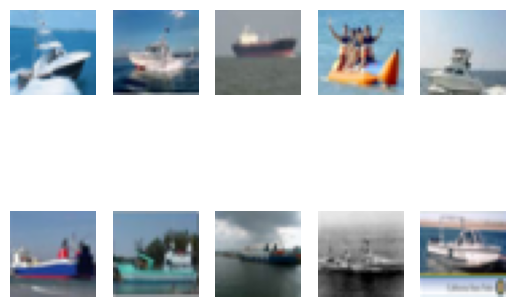

In [ ]:
plot_img(x_train)

# **Create Model**

In [ ]:
# Khởi thạo tham số và mô hình

epochs = 200
learning_rate=0.0002
BATCH_SIZE=64
n_critic=3
latent_dim=256

In [ ]:
from keras.models import Sequential
from keras.optimizers import RMSprop, Adam
from keras.layers import Conv2D, Dense, Flatten, BatchNormalization, LeakyReLU, Reshape, Conv2DTranspose, Dropout, ZeroPadding2D, InputLayer, Cropping2D

### **Critic**

In [ ]:
def _critic(input_shape=(32,32,3)):
  model = Sequential()

  model.add(InputLayer(input_shape=input_shape))
  # model.add(ZeroPadding2D((2,2)))

  model.add(Conv2D(32, (4,4), strides=(2,2), padding='same'))
  model.add(BatchNormalization())
  model.add(LeakyReLU(0.2))

  model.add(Conv2D(64, (4,4), strides=(2,2), padding='same'))
  model.add(BatchNormalization())
  model.add(LeakyReLU(0.2))

  model.add(Flatten())
  model.add(Dense(1))

  return model

In [ ]:
critic = _critic()
critic.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_4 (Conv2D)           (None, 16, 16, 32)        1568      
                                                                 
 batch_normalization_6 (Batc  (None, 16, 16, 32)       128       
 hNormalization)                                                 
                                                                 
 leaky_re_lu_8 (LeakyReLU)   (None, 16, 16, 32)        0         
                                                                 
 conv2d_5 (Conv2D)           (None, 8, 8, 64)          32832     
                                                                 
 batch_normalization_7 (Batc  (None, 8, 8, 64)         256       
 hNormalization)                                                 
                                                                 
 leaky_re_lu_9 (LeakyReLU)   (None, 8, 8, 64)         

### **Generator**

In [ ]:
def _generator(latent_dim):
  n_dims = 8 * 8 * 128
  model = Sequential()

  model.add(Dense(n_dims, input_shape=(latent_dim,)))
  model.add(LeakyReLU(0.2))
  model.add(Reshape((8, 8, 128)))

  model.add(Conv2DTranspose(64, (4,4), strides=(2, 2), padding='same'))
  model.add(BatchNormalization())
  model.add(LeakyReLU(0.2))

  model.add(Conv2DTranspose(32, (4,4), strides=(2, 2), padding='same'))
  model.add(BatchNormalization())
  model.add(LeakyReLU(0.2))

  model.add(Conv2D(3, (7,7), strides=(1,1), padding='same', activation='tanh'))

  return model

In [ ]:
generator = _generator(latent_dim)
generator.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_4 (Dense)             (None, 8192)              2105344   
                                                                 
 leaky_re_lu_10 (LeakyReLU)  (None, 8192)              0         
                                                                 
 reshape_1 (Reshape)         (None, 8, 8, 128)         0         
                                                                 
 conv2d_transpose_3 (Conv2DT  (None, 16, 16, 64)       131136    
 ranspose)                                                       
                                                                 
 batch_normalization_8 (Batc  (None, 16, 16, 64)       256       
 hNormalization)                                                 
                                                                 
 leaky_re_lu_11 (LeakyReLU)  (None, 16, 16, 64)       

## **WGAN Model**

In [ ]:
import tensorflow as tf
from keras.models import Model
from keras.callbacks import Callback
from keras.optimizers import Adam

### **WGAN**

In [ ]:
class WGAN(Model):
    def __init__(
        self,
        discriminator,
        generator,
        latent_dim,
        discriminator_extra_steps=3,
        gp_weight=10.0,
    ):
        super(WGAN, self).__init__()
        self.discriminator = discriminator
        self.generator = generator
        self.latent_dim = latent_dim
        self.d_steps = discriminator_extra_steps
        self.gp_weight = gp_weight

    def compile(self, d_optimizer, g_optimizer, d_loss_fn, g_loss_fn):
        super(WGAN, self).compile()
        self.d_optimizer = d_optimizer
        self.g_optimizer = g_optimizer
        self.d_loss_fn = d_loss_fn
        self.g_loss_fn = g_loss_fn

    def gradient_penalty(self, batch_size, real_images, fake_images):
        """
        Tính toán phạt cho gradient
        hàm loss này được tính toán trên ảnh interpolated và được thêm vào discriminator loss
        """
        # tạo interplated image
        alpha = tf.random.normal([batch_size, 1, 1, 1], 0.0, 1.0)
        diff = fake_images - real_images
        interpolated = real_images + alpha * diff

        with tf.GradientTape() as gp_tape:
            gp_tape.watch(interpolated)
            # 1. dự đoán discriminator output cho interpolated image.
            pred = self.discriminator(interpolated, training=True)

        # 2. Tính gradients cho interpolated image.
        grads = gp_tape.gradient(pred, [interpolated])[0]
        # 3. Tính norm của gradients
        norm = tf.sqrt(tf.reduce_sum(tf.square(grads), axis=[1, 2, 3]))
        gp = tf.reduce_mean((norm - 1.0) ** 2)
        return gp

    def train_step(self, real_images):
        if isinstance(real_images, tuple):
            real_images = real_images[0]
        batch_size = tf.shape(real_images)[0]

        # Với mỗi một batch chúng ta sẽ thực hiện những bước sau
        # following steps as laid out in the original paper.
        # 1. Lấy mẫu ngẫu nhiên ảnh real và ảnh fake. Trong đó ảnh real được lựa chọn từ mô hình và ảnh fake được tạo ra từ generator từ một véc tơ ngẫu nhiên.
        # 2. Tính toán phạt cho gradient dựa trên chênh lệch giữa ảnh real và ảnh fake. Gradient được lấy trong bối cảnh của hàm `tf.GradientTape()`.
        # 3. Nhân phạt của gradient với một giá trị hệ số alpha.
        # 4. Tính loss function cho discirminator
        # 5. Thêm phạt gradient vào loss function của discriminator
        # 6. Cập nhật gradient theo loss function của discriminator và generator thông qua hàm `tape.apply_gradients()`
        # Chúng ta sẽ huấn luyện discrimnator với d_steps trước. và sau đó chúng ta mới huấn luyện generator.
        # Như vậy cùng một batch thì discriminator được huấn luyện gấp d_steps lần so với generator.

        # Huấn luyện critic
        for i in range(self.d_steps):
            # Khởi tạo latent vector
            random_latent_vectors = tf.random.normal(
                shape=(batch_size, self.latent_dim)
            )

            # Chúng ta phải thực thi trong tf.GradientTap() để lấy được giá trị gradient.
            with tf.GradientTape() as tape:
                # Tạo ảnh fake từ latent vector
                fake_images = self.generator(random_latent_vectors, training=True)
                # Dự báo điểm cho ảnh fake
                fake_logits = self.discriminator(fake_images, training=True)
                # Dự báo điểm cho ảnh real
                real_logits = self.discriminator(real_images, training=True)

                # Tính discriminator loss từ ảnh real và ảnh fake
                d_cost = self.d_loss_fn(real_img=real_logits, fake_img=fake_logits)
                # Tính phạt gradient
                gp = self.gradient_penalty(batch_size, real_images, fake_images)
                # Thêm phạt gradient cho discriminator loss ban đầu
                d_loss = d_cost + gp * self.gp_weight

            # Lấy gradient của discriminator loss
            d_gradient = tape.gradient(d_loss, self.discriminator.trainable_variables)

            # Cập nhật weights của discriminator sử dụng discriminator optimizer
            self.d_optimizer.apply_gradients(
                zip(d_gradient, self.discriminator.trainable_variables)
            )

        # Huấn luyện generator
        # Khởi tạo véc tơ latent
        random_latent_vectors = tf.random.normal(shape=(batch_size, self.latent_dim))
        with tf.GradientTape() as tape:
            # Tạo ảnh fake từ generator
            generated_images = self.generator(random_latent_vectors, training=True)
            # Get the discriminator logits for fake images
            # Dự báo điểm cho ảnh fake từ discriminator
            gen_img_logits = self.discriminator(generated_images, training=True)
            # Tính generator loss
            g_loss = self.g_loss_fn(gen_img_logits)

        # Lấy gradient cho generator loss
        gen_gradient = tape.gradient(g_loss, self.generator.trainable_variables)
        # Cập nhật hệ số của generator sử dụng generator optimizer
        self.g_optimizer.apply_gradients(
            zip(gen_gradient, self.generator.trainable_variables)
        )
        return {"d_loss": d_loss, "g_loss": g_loss}

### **Callback**

In [ ]:
class GANMonitor(Callback):
    def __init__(self, num_img, latent_dim):
        self.num_img = num_img
        self.latent_dim = latent_dim

    def on_epoch_end(self, epoch, logs=None):
        random_latent_vectors = tf.random.normal(shape=(self.num_img, self.latent_dim))
        generated_images = self.model.generator(random_latent_vectors, training=True)
        plot_img(generated_images)

### **Training**

In [ ]:
# Khởi tạo optimizer
# learning_rate=0.0002, beta_1=0.5 được khuyến nghị
generator_optimizer = Adam(
    learning_rate=learning_rate, beta_1=0.5, beta_2=0.9
)
discriminator_optimizer = Adam(
    learning_rate=learning_rate, beta_1=0.5, beta_2=0.9
)

# Define the loss functions to be used for discrimiator
# This should be (fake_loss - real_loss)
# We will add the gradient penalty later to this loss function

# Xác định loss functions được sử dụng cho discriminator = (fake_loss - real_loss).
# Ở hàm train_step của WGAN chúng ta phải thêm phạt gradient penalty cho hàm này.
def discriminator_loss(real_img, fake_img):
    real_loss = tf.reduce_mean(real_img)
    fake_loss = tf.reduce_mean(fake_img)
    return fake_loss - real_loss

# Xác định loss function cho generator.
def generator_loss(fake_img):
    return -tf.reduce_mean(fake_img)

# Callbacks
cbk = GANMonitor(num_img=10, latent_dim=latent_dim)

# wgan model
wgan = WGAN(
    discriminator=critic,
    generator=generator,
    latent_dim=latent_dim,
    discriminator_extra_steps=n_critic,
)

# Compile model
wgan.compile(
    d_optimizer=discriminator_optimizer,
    g_optimizer=generator_optimizer,
    g_loss_fn=generator_loss,
    d_loss_fn=discriminator_loss,
)

Epoch 1/200
78/79 [============================>.] - ETA: 0s - d_loss: -9.6471 - g_loss: 2.2662

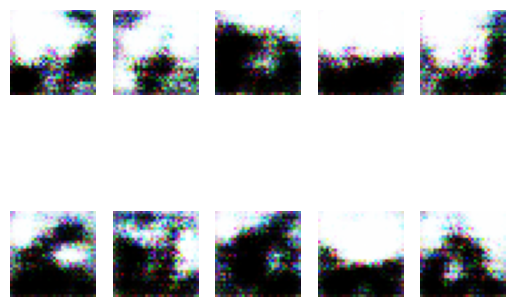

79/79 [==============================] - 10s 40ms/step - d_loss: -9.6436 - g_loss: 2.4537
Epoch 2/200
79/79 [==============================] - ETA: 0s - d_loss: -13.4945 - g_loss: 20.1314

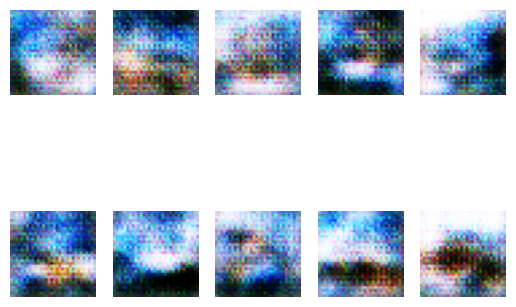

79/79 [==============================] - 3s 44ms/step - d_loss: -13.3548 - g_loss: 20.1659
Epoch 3/200
78/79 [============================>.] - ETA: 0s - d_loss: -11.8063 - g_loss: 18.8118

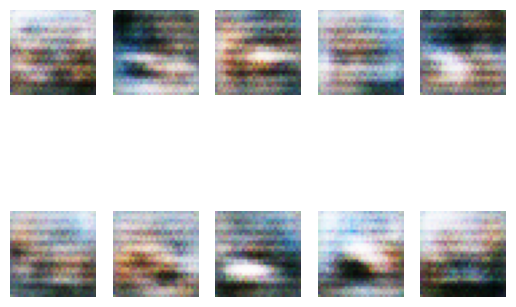

79/79 [==============================] - 3s 43ms/step - d_loss: -11.5036 - g_loss: 18.7473
Epoch 4/200
78/79 [============================>.] - ETA: 0s - d_loss: -11.3487 - g_loss: 14.7147

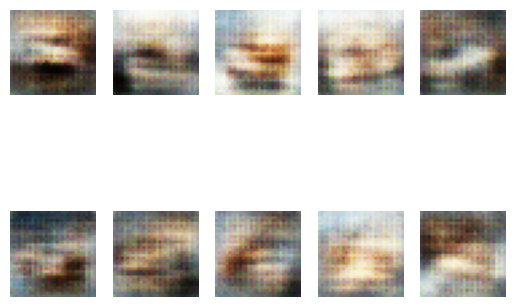

79/79 [==============================] - 4s 54ms/step - d_loss: -11.3781 - g_loss: 14.7477
Epoch 5/200
79/79 [==============================] - ETA: 0s - d_loss: -10.9289 - g_loss: 12.9549

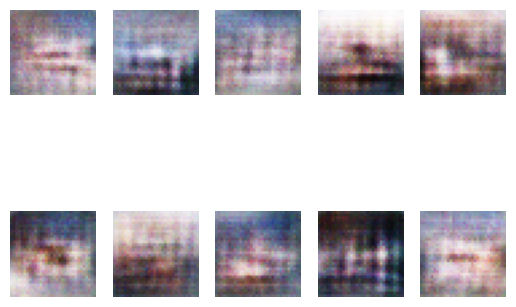

79/79 [==============================] - 3s 41ms/step - d_loss: -10.9204 - g_loss: 12.8585
Epoch 6/200
78/79 [============================>.] - ETA: 0s - d_loss: -11.5404 - g_loss: 12.4952

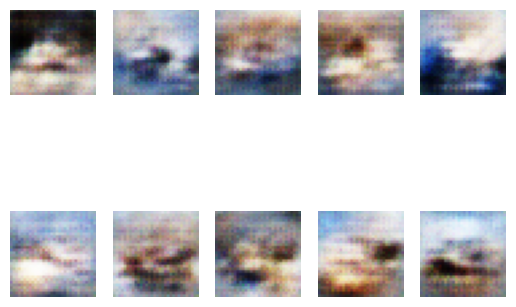

79/79 [==============================] - 4s 50ms/step - d_loss: -11.5277 - g_loss: 12.4826
Epoch 7/200
78/79 [============================>.] - ETA: 0s - d_loss: -11.7416 - g_loss: 12.1600

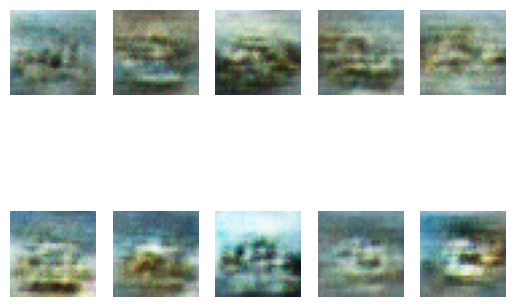

79/79 [==============================] - 4s 48ms/step - d_loss: -11.7418 - g_loss: 12.0845
Epoch 8/200
79/79 [==============================] - ETA: 0s - d_loss: -11.2363 - g_loss: 10.4859

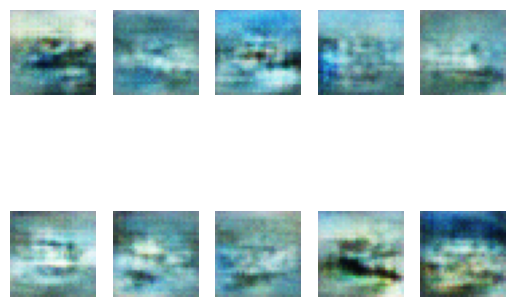

79/79 [==============================] - 4s 55ms/step - d_loss: -11.2832 - g_loss: 10.4132
Epoch 9/200
79/79 [==============================] - ETA: 0s - d_loss: -10.6081 - g_loss: 7.8132

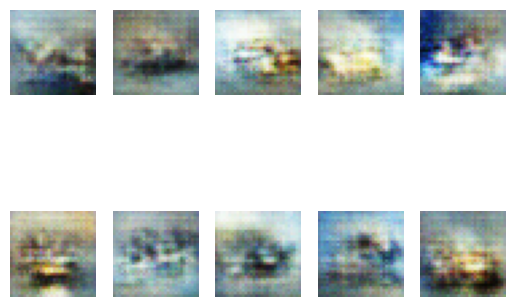

79/79 [==============================] - 4s 46ms/step - d_loss: -10.6471 - g_loss: 7.8030
Epoch 10/200
79/79 [==============================] - ETA: 0s - d_loss: -9.8180 - g_loss: 5.1586

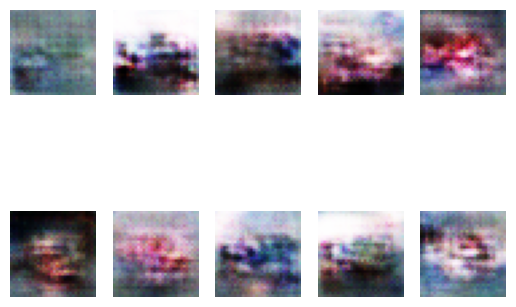

79/79 [==============================] - 3s 43ms/step - d_loss: -9.8953 - g_loss: 5.1215
Epoch 11/200
79/79 [==============================] - ETA: 0s - d_loss: -7.6777 - g_loss: 1.7621

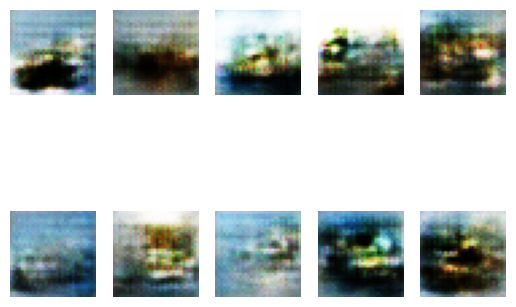

79/79 [==============================] - 4s 51ms/step - d_loss: -7.6634 - g_loss: 1.7190
Epoch 12/200
78/79 [============================>.] - ETA: 0s - d_loss: -6.7752 - g_loss: 0.0252

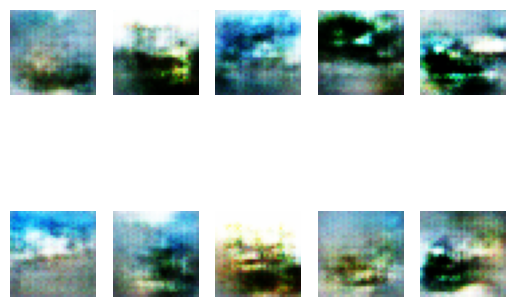

79/79 [==============================] - 4s 56ms/step - d_loss: -6.7882 - g_loss: -0.0552
Epoch 13/200
78/79 [============================>.] - ETA: 0s - d_loss: -6.1118 - g_loss: 0.2738

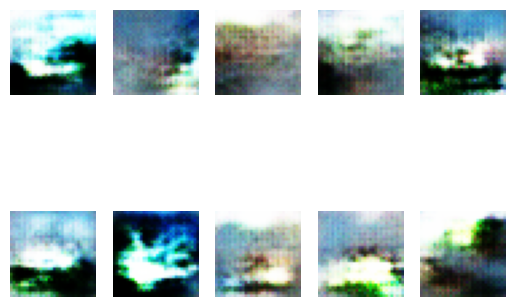

79/79 [==============================] - 4s 46ms/step - d_loss: -6.0336 - g_loss: 0.2720
Epoch 14/200
79/79 [==============================] - ETA: 0s - d_loss: -5.7885 - g_loss: 2.2037

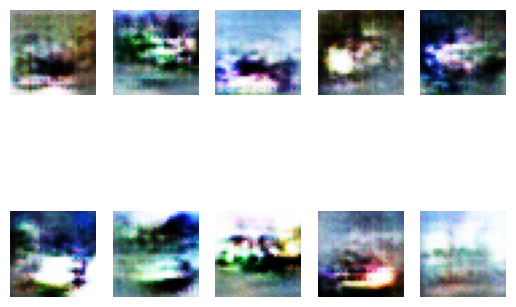

79/79 [==============================] - 4s 46ms/step - d_loss: -5.7506 - g_loss: 2.2335
Epoch 15/200
79/79 [==============================] - ETA: 0s - d_loss: -5.5270 - g_loss: 3.7559

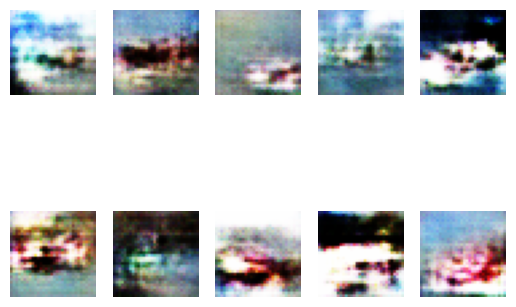

79/79 [==============================] - 4s 52ms/step - d_loss: -5.5382 - g_loss: 3.7270
Epoch 16/200
78/79 [============================>.] - ETA: 0s - d_loss: -5.4647 - g_loss: 4.2917

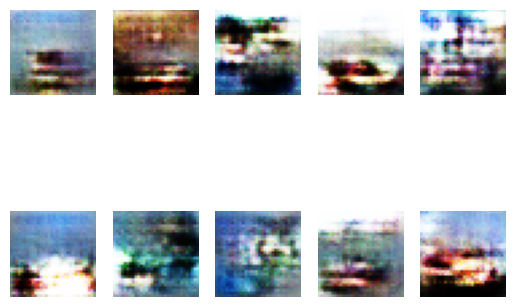

79/79 [==============================] - 5s 67ms/step - d_loss: -5.4442 - g_loss: 4.1518
Epoch 17/200
78/79 [============================>.] - ETA: 0s - d_loss: -5.6423 - g_loss: 4.0985

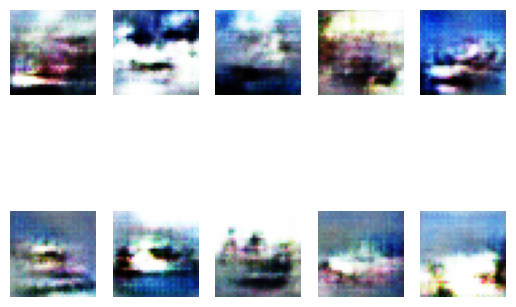

79/79 [==============================] - 4s 49ms/step - d_loss: -5.5905 - g_loss: 4.0203
Epoch 18/200
79/79 [==============================] - ETA: 0s - d_loss: -5.7678 - g_loss: 4.2280

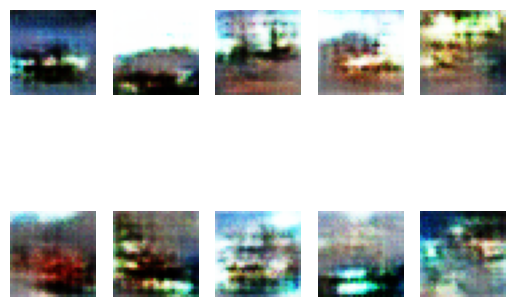

79/79 [==============================] - 4s 48ms/step - d_loss: -5.8180 - g_loss: 4.2215
Epoch 19/200
78/79 [============================>.] - ETA: 0s - d_loss: -5.9148 - g_loss: 5.1480

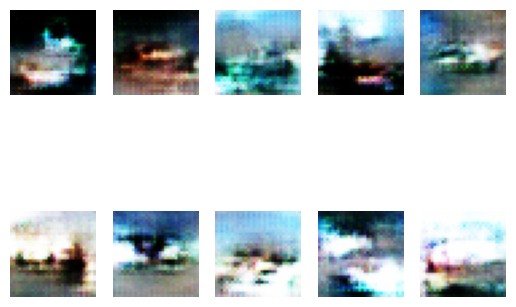

79/79 [==============================] - 5s 57ms/step - d_loss: -5.9836 - g_loss: 5.2184
Epoch 20/200
78/79 [============================>.] - ETA: 0s - d_loss: -6.2503 - g_loss: 5.5298

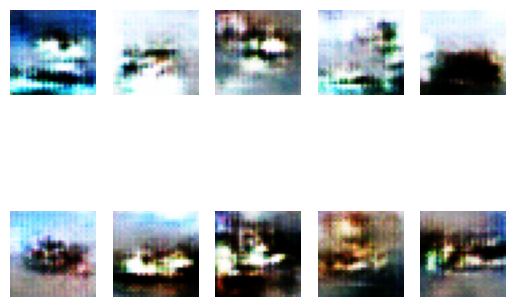

79/79 [==============================] - 5s 61ms/step - d_loss: -6.3520 - g_loss: 5.5163
Epoch 21/200
78/79 [============================>.] - ETA: 0s - d_loss: -6.7001 - g_loss: 6.5741

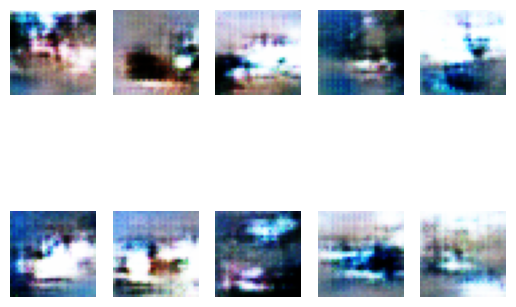

79/79 [==============================] - 4s 55ms/step - d_loss: -6.6024 - g_loss: 6.6385
Epoch 22/200
78/79 [============================>.] - ETA: 0s - d_loss: -6.6638 - g_loss: 5.4048

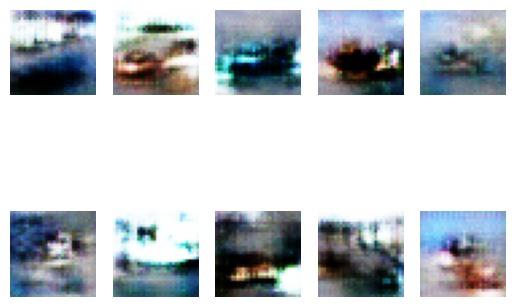

79/79 [==============================] - 4s 51ms/step - d_loss: -6.5354 - g_loss: 5.5169
Epoch 23/200
79/79 [==============================] - ETA: 0s - d_loss: -6.6407 - g_loss: 5.1029

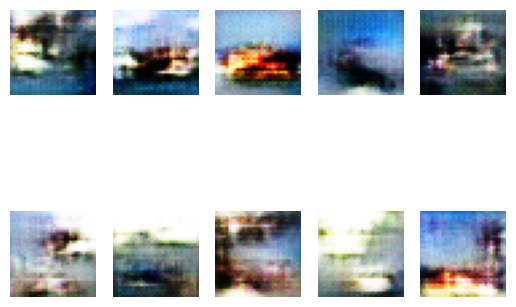

79/79 [==============================] - 5s 64ms/step - d_loss: -6.6881 - g_loss: 5.1166
Epoch 24/200
79/79 [==============================] - ETA: 0s - d_loss: -6.7321 - g_loss: 5.3632

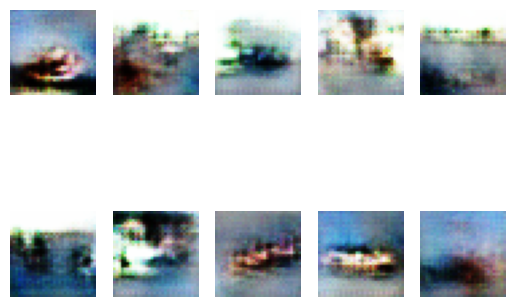

79/79 [==============================] - 5s 58ms/step - d_loss: -6.7643 - g_loss: 5.3986
Epoch 25/200
79/79 [==============================] - ETA: 0s - d_loss: -6.8934 - g_loss: 5.1966

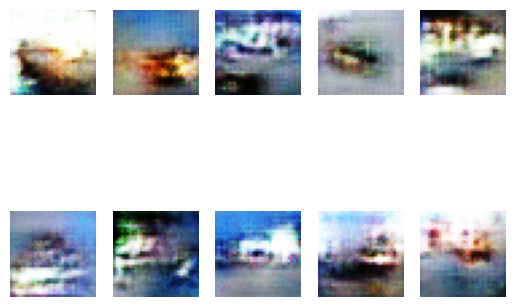

79/79 [==============================] - 4s 55ms/step - d_loss: -6.9280 - g_loss: 5.1732
Epoch 26/200
78/79 [============================>.] - ETA: 0s - d_loss: -6.9706 - g_loss: 4.6671

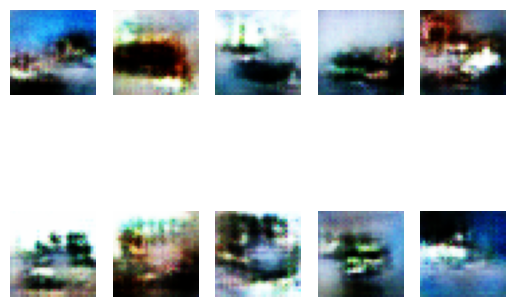

79/79 [==============================] - 5s 58ms/step - d_loss: -6.7312 - g_loss: 4.6814
Epoch 27/200
79/79 [==============================] - ETA: 0s - d_loss: -6.7801 - g_loss: 4.2741

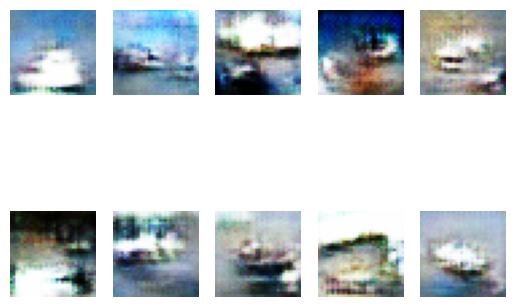

79/79 [==============================] - 5s 63ms/step - d_loss: -6.7698 - g_loss: 4.2528
Epoch 28/200
78/79 [============================>.] - ETA: 0s - d_loss: -6.5785 - g_loss: 4.4827

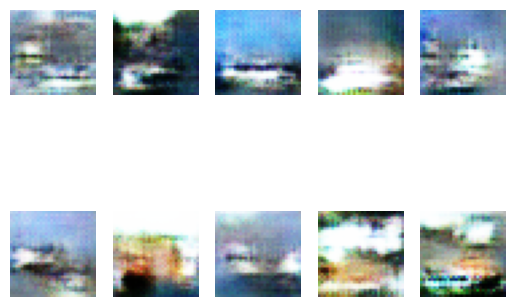

79/79 [==============================] - 5s 58ms/step - d_loss: -6.7436 - g_loss: 4.4217
Epoch 29/200
78/79 [============================>.] - ETA: 0s - d_loss: -6.6630 - g_loss: 4.8467

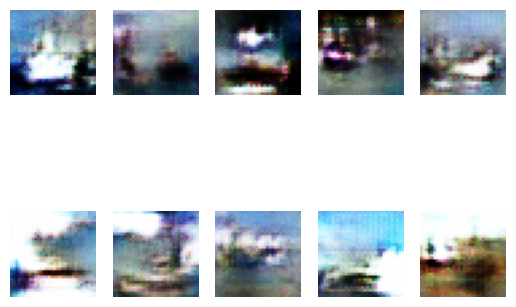

79/79 [==============================] - 4s 55ms/step - d_loss: -6.5178 - g_loss: 4.8837
Epoch 30/200
79/79 [==============================] - ETA: 0s - d_loss: -6.6441 - g_loss: 3.8928

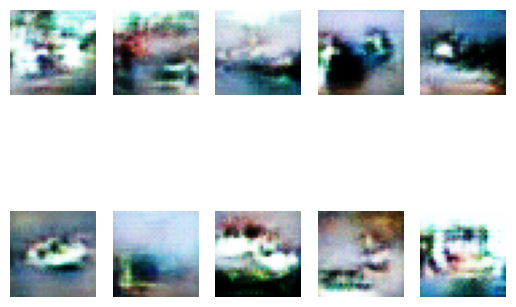

79/79 [==============================] - 5s 63ms/step - d_loss: -6.6759 - g_loss: 3.8797
Epoch 31/200
78/79 [============================>.] - ETA: 0s - d_loss: -6.6866 - g_loss: 3.7699

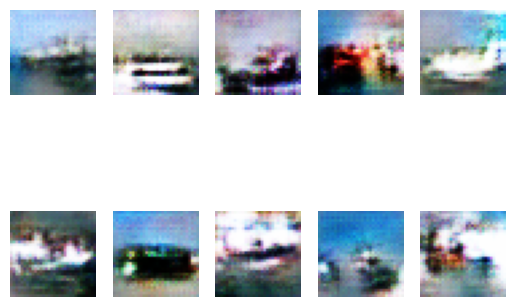

79/79 [==============================] - 5s 60ms/step - d_loss: -6.6845 - g_loss: 3.8743
Epoch 32/200
79/79 [==============================] - ETA: 0s - d_loss: -6.3203 - g_loss: 4.0540

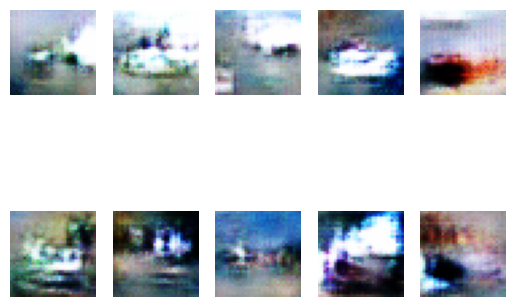

79/79 [==============================] - 5s 57ms/step - d_loss: -6.1543 - g_loss: 4.0623
Epoch 33/200
78/79 [============================>.] - ETA: 0s - d_loss: -6.3726 - g_loss: 3.5241

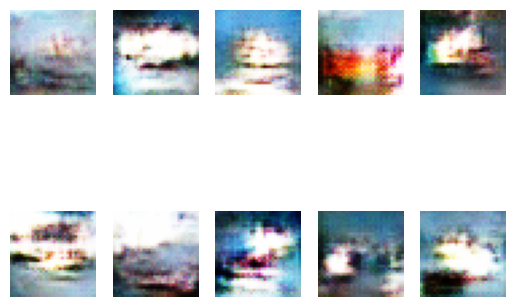

79/79 [==============================] - 4s 55ms/step - d_loss: -6.2412 - g_loss: 3.4284
Epoch 34/200
79/79 [==============================] - ETA: 0s - d_loss: -6.3263 - g_loss: 3.8860

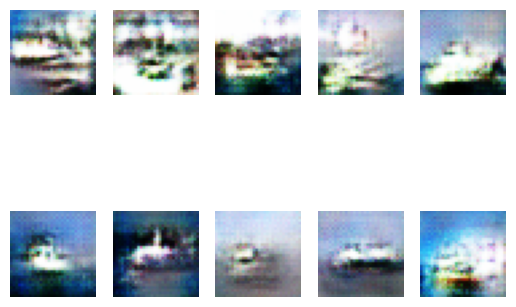

79/79 [==============================] - 5s 63ms/step - d_loss: -6.2634 - g_loss: 3.8554
Epoch 35/200
78/79 [============================>.] - ETA: 0s - d_loss: -6.1680 - g_loss: 4.7428

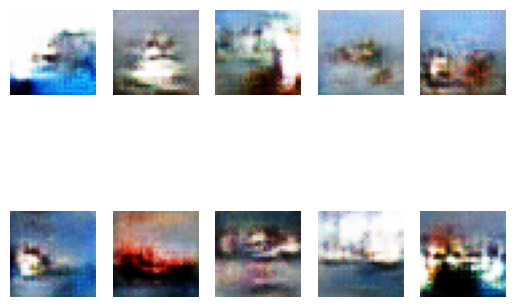

79/79 [==============================] - 5s 59ms/step - d_loss: -6.1944 - g_loss: 4.7377
Epoch 36/200
78/79 [============================>.] - ETA: 0s - d_loss: -6.1820 - g_loss: 4.0560

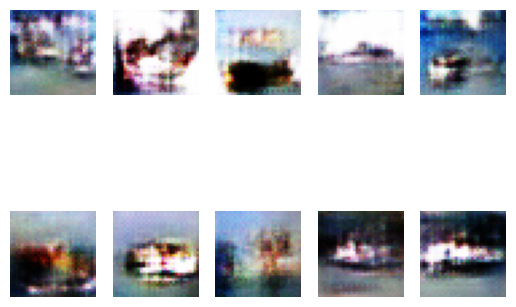

79/79 [==============================] - 4s 55ms/step - d_loss: -6.2360 - g_loss: 4.0897
Epoch 37/200
78/79 [============================>.] - ETA: 0s - d_loss: -6.1478 - g_loss: 4.4218

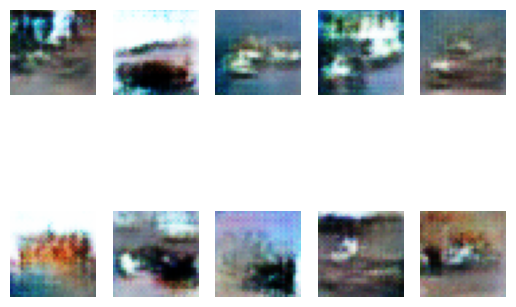

79/79 [==============================] - 5s 62ms/step - d_loss: -6.2855 - g_loss: 4.3636
Epoch 38/200
78/79 [============================>.] - ETA: 0s - d_loss: -6.3258 - g_loss: 4.4554

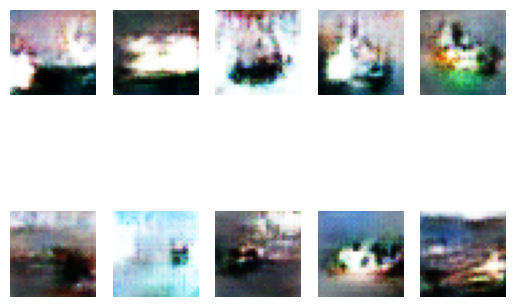

79/79 [==============================] - 5s 63ms/step - d_loss: -6.3101 - g_loss: 4.4181
Epoch 39/200
78/79 [============================>.] - ETA: 0s - d_loss: -6.0551 - g_loss: 5.0534

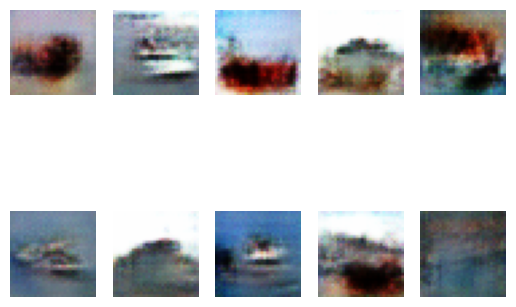

79/79 [==============================] - 4s 57ms/step - d_loss: -6.0672 - g_loss: 5.0505
Epoch 40/200
78/79 [============================>.] - ETA: 0s - d_loss: -5.8206 - g_loss: 4.4903

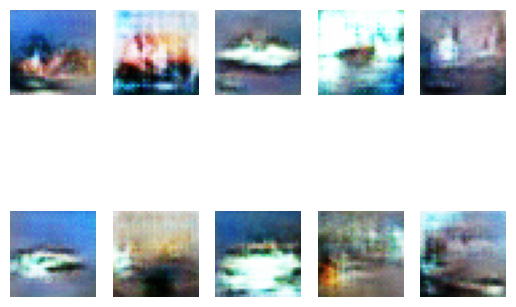

79/79 [==============================] - 4s 56ms/step - d_loss: -5.9087 - g_loss: 4.6049
Epoch 41/200
79/79 [==============================] - ETA: 0s - d_loss: -5.6165 - g_loss: 4.6972

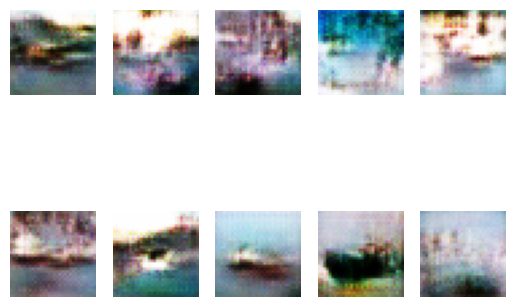

79/79 [==============================] - 5s 62ms/step - d_loss: -5.5438 - g_loss: 4.6529
Epoch 42/200
78/79 [============================>.] - ETA: 0s - d_loss: -5.6463 - g_loss: 4.0790

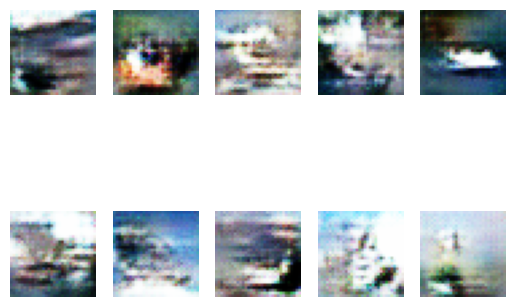

79/79 [==============================] - 5s 59ms/step - d_loss: -5.7177 - g_loss: 4.1869
Epoch 43/200
78/79 [============================>.] - ETA: 0s - d_loss: -5.7072 - g_loss: 4.8714

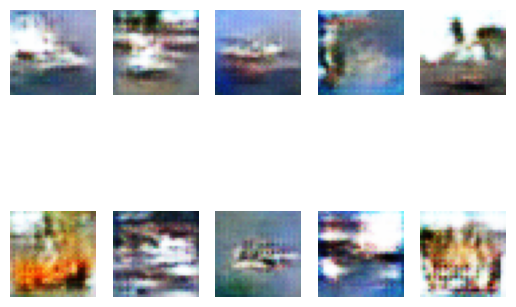

79/79 [==============================] - 4s 55ms/step - d_loss: -5.7595 - g_loss: 4.8366
Epoch 44/200
79/79 [==============================] - ETA: 0s - d_loss: -5.4166 - g_loss: 5.1421

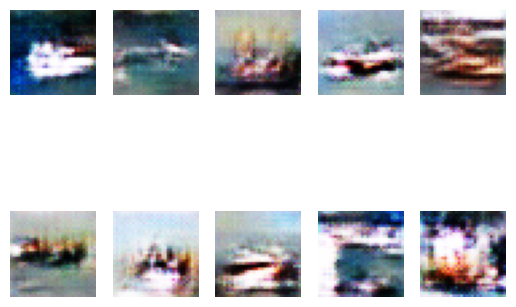

79/79 [==============================] - 5s 63ms/step - d_loss: -5.4139 - g_loss: 5.1301
Epoch 45/200
78/79 [============================>.] - ETA: 0s - d_loss: -5.2293 - g_loss: 4.7869

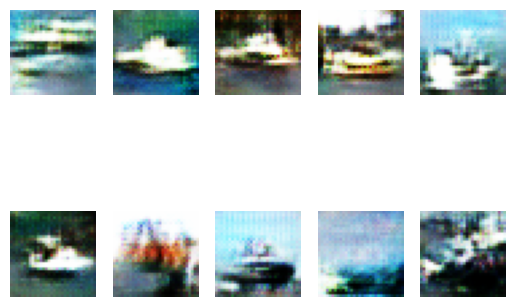

79/79 [==============================] - 5s 64ms/step - d_loss: -4.5990 - g_loss: 4.7061
Epoch 46/200
78/79 [============================>.] - ETA: 0s - d_loss: -5.2860 - g_loss: 5.0765

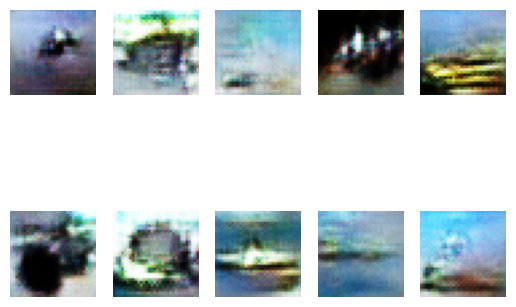

79/79 [==============================] - 4s 55ms/step - d_loss: -5.3000 - g_loss: 4.9579
Epoch 47/200
79/79 [==============================] - ETA: 0s - d_loss: -5.0576 - g_loss: 6.3124

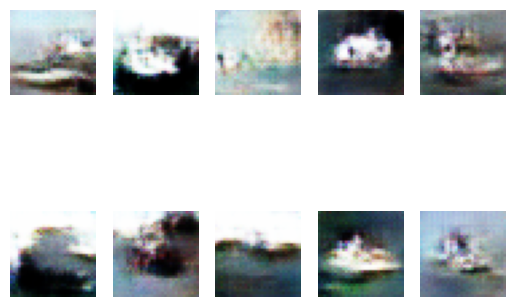

79/79 [==============================] - 4s 56ms/step - d_loss: -5.0855 - g_loss: 6.3267
Epoch 48/200
79/79 [==============================] - ETA: 0s - d_loss: -4.8350 - g_loss: 5.6569

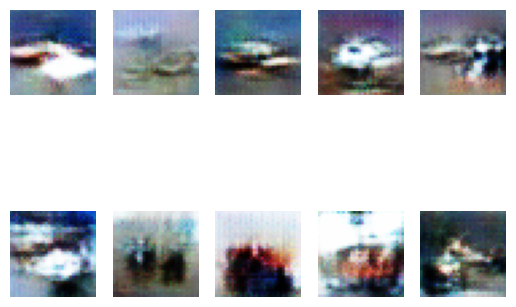

79/79 [==============================] - 5s 62ms/step - d_loss: -4.7064 - g_loss: 5.6485
Epoch 49/200
78/79 [============================>.] - ETA: 0s - d_loss: -5.2604 - g_loss: 5.5863

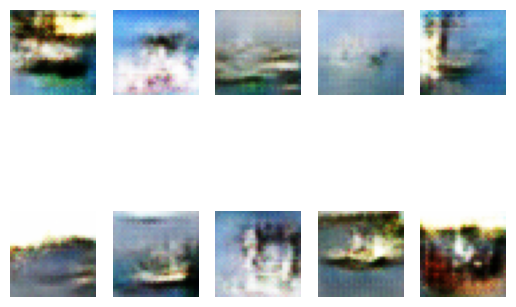

79/79 [==============================] - 5s 60ms/step - d_loss: -5.2928 - g_loss: 5.5575
Epoch 50/200
78/79 [============================>.] - ETA: 0s - d_loss: -4.9670 - g_loss: 6.5658

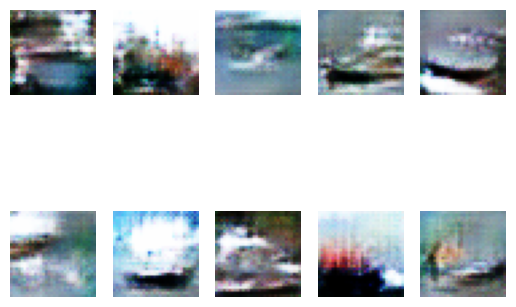

79/79 [==============================] - 4s 55ms/step - d_loss: -4.6568 - g_loss: 6.4844
Epoch 51/200
78/79 [============================>.] - ETA: 0s - d_loss: -4.7059 - g_loss: 5.5952

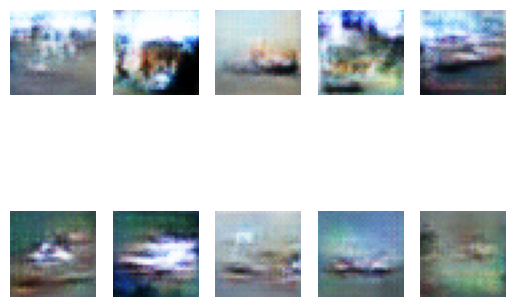

79/79 [==============================] - 5s 63ms/step - d_loss: -4.5847 - g_loss: 5.6343
Epoch 52/200
79/79 [==============================] - ETA: 0s - d_loss: -4.6748 - g_loss: 5.8487

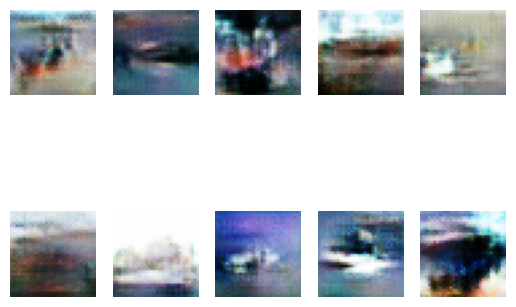

79/79 [==============================] - 5s 61ms/step - d_loss: -4.6730 - g_loss: 5.8178
Epoch 53/200
78/79 [============================>.] - ETA: 0s - d_loss: -4.7289 - g_loss: 5.7686

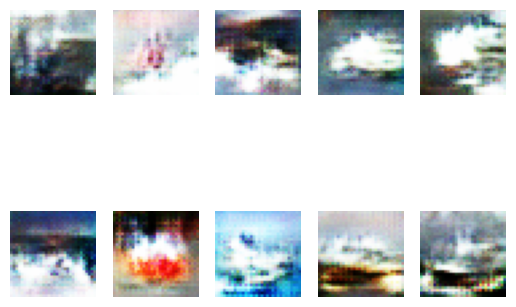

79/79 [==============================] - 4s 56ms/step - d_loss: -4.8356 - g_loss: 5.7555
Epoch 54/200
78/79 [============================>.] - ETA: 0s - d_loss: -4.6454 - g_loss: 6.5101

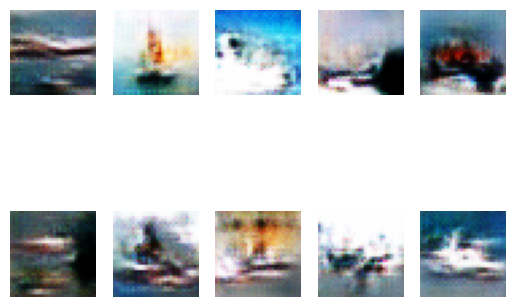

79/79 [==============================] - 4s 55ms/step - d_loss: -4.7582 - g_loss: 6.4750
Epoch 55/200
79/79 [==============================] - ETA: 0s - d_loss: -4.3873 - g_loss: 6.2734

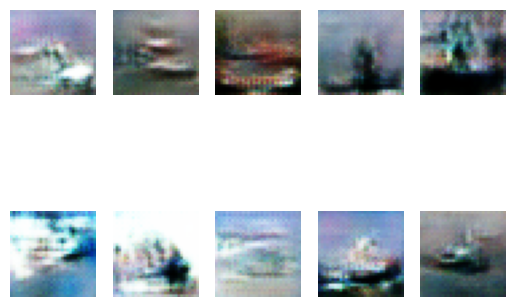

79/79 [==============================] - 5s 60ms/step - d_loss: -4.2461 - g_loss: 6.3039
Epoch 56/200
79/79 [==============================] - ETA: 0s - d_loss: -4.3984 - g_loss: 6.5300

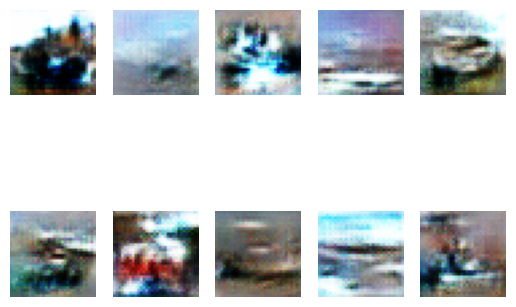

79/79 [==============================] - 5s 61ms/step - d_loss: -4.3817 - g_loss: 6.4911
Epoch 57/200
79/79 [==============================] - ETA: 0s - d_loss: -4.2912 - g_loss: 5.5523

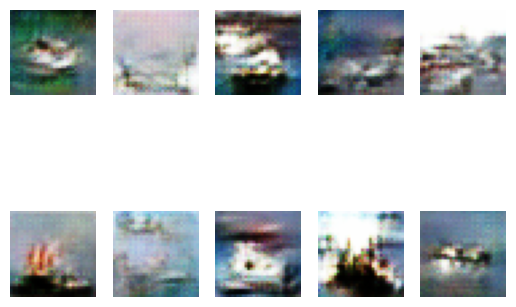

79/79 [==============================] - 4s 56ms/step - d_loss: -4.2353 - g_loss: 5.5818
Epoch 58/200
78/79 [============================>.] - ETA: 0s - d_loss: -4.5271 - g_loss: 6.0688

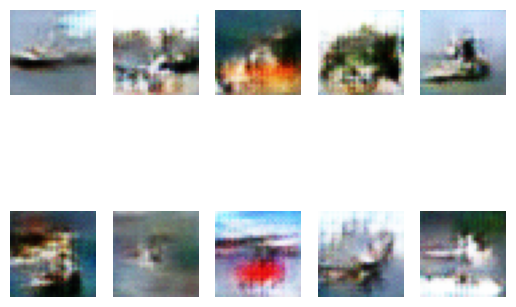

79/79 [==============================] - 5s 61ms/step - d_loss: -4.3448 - g_loss: 5.8286
Epoch 59/200
79/79 [==============================] - ETA: 0s - d_loss: -3.8802 - g_loss: 6.0998

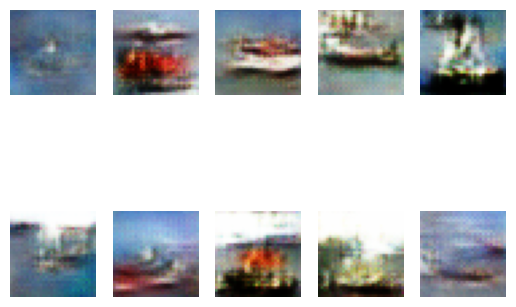

79/79 [==============================] - 5s 62ms/step - d_loss: -3.4400 - g_loss: 6.1323
Epoch 60/200
78/79 [============================>.] - ETA: 0s - d_loss: -4.0995 - g_loss: 5.9086

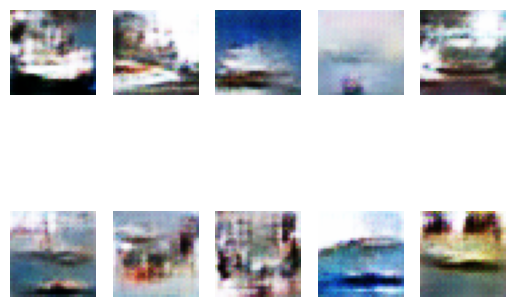

79/79 [==============================] - 4s 56ms/step - d_loss: -3.7760 - g_loss: 5.9145
Epoch 61/200
79/79 [==============================] - ETA: 0s - d_loss: -4.1544 - g_loss: 5.7282

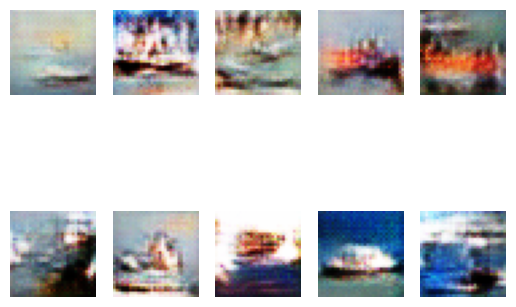

79/79 [==============================] - 4s 56ms/step - d_loss: -4.1175 - g_loss: 5.6760
Epoch 62/200
79/79 [==============================] - ETA: 0s - d_loss: -4.1170 - g_loss: 6.4058

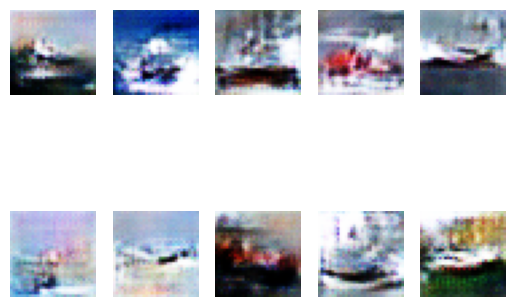

79/79 [==============================] - 4s 56ms/step - d_loss: -4.1438 - g_loss: 6.4296
Epoch 63/200
79/79 [==============================] - ETA: 0s - d_loss: -4.1655 - g_loss: 5.6220

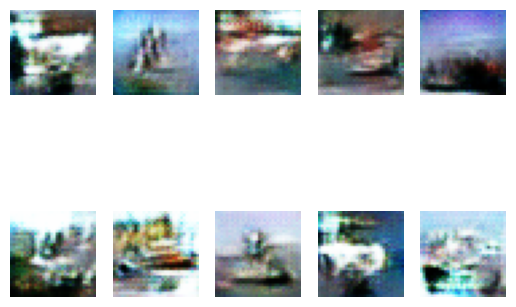

79/79 [==============================] - 5s 66ms/step - d_loss: -4.1477 - g_loss: 5.6141
Epoch 64/200
79/79 [==============================] - ETA: 0s - d_loss: -4.2779 - g_loss: 6.1064

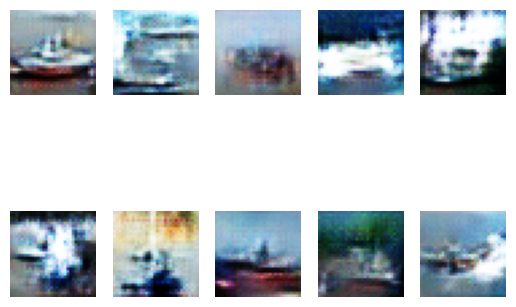

79/79 [==============================] - 4s 57ms/step - d_loss: -4.2512 - g_loss: 6.0874
Epoch 65/200
78/79 [============================>.] - ETA: 0s - d_loss: -3.9094 - g_loss: 4.9462

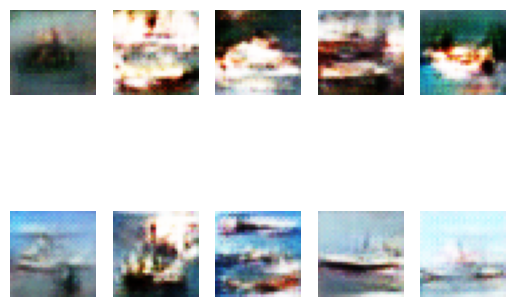

79/79 [==============================] - 5s 60ms/step - d_loss: -4.0027 - g_loss: 4.9524
Epoch 66/200
79/79 [==============================] - ETA: 0s - d_loss: -3.7460 - g_loss: 5.2546

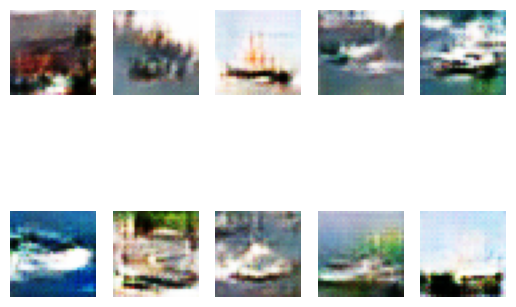

79/79 [==============================] - 5s 64ms/step - d_loss: -3.8275 - g_loss: 5.3188
Epoch 67/200
78/79 [============================>.] - ETA: 0s - d_loss: -3.6698 - g_loss: 5.6211

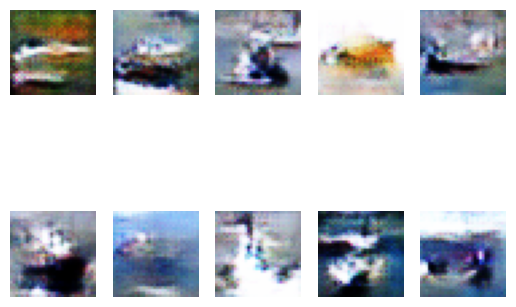

79/79 [==============================] - 5s 61ms/step - d_loss: -3.4102 - g_loss: 5.5589
Epoch 68/200
78/79 [============================>.] - ETA: 0s - d_loss: -3.8559 - g_loss: 5.4717

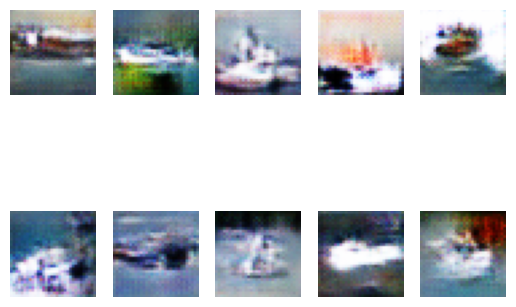

79/79 [==============================] - 4s 57ms/step - d_loss: -3.8860 - g_loss: 5.5010
Epoch 69/200
79/79 [==============================] - ETA: 0s - d_loss: -3.8310 - g_loss: 4.2821

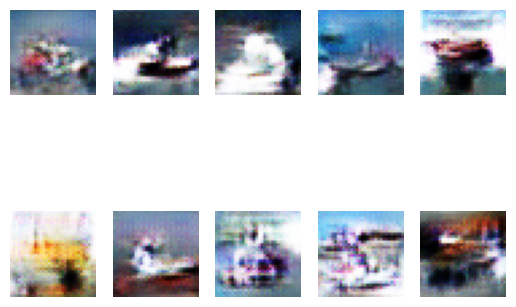

79/79 [==============================] - 5s 60ms/step - d_loss: -3.8384 - g_loss: 4.2683
Epoch 70/200
79/79 [==============================] - ETA: 0s - d_loss: -3.3926 - g_loss: 4.2109

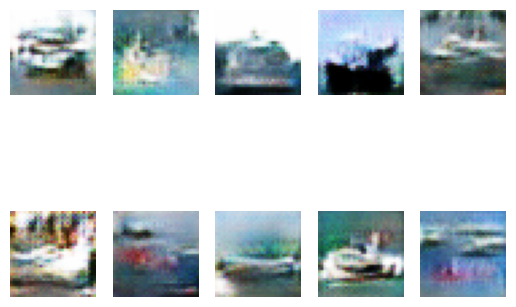

79/79 [==============================] - 5s 64ms/step - d_loss: -3.1100 - g_loss: 4.1956
Epoch 71/200
79/79 [==============================] - ETA: 0s - d_loss: -3.5143 - g_loss: 5.5660

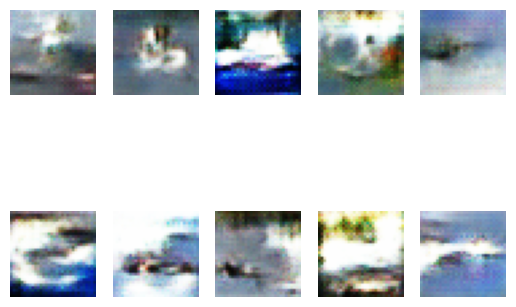

79/79 [==============================] - 5s 57ms/step - d_loss: -3.4467 - g_loss: 5.6108
Epoch 72/200
78/79 [============================>.] - ETA: 0s - d_loss: -3.7466 - g_loss: 3.4647

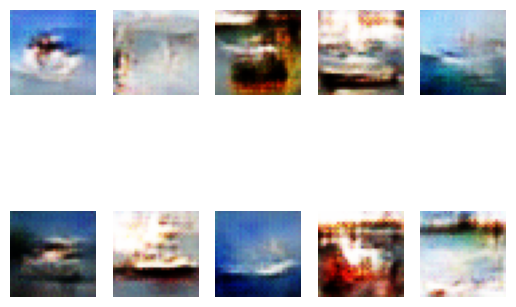

79/79 [==============================] - 5s 59ms/step - d_loss: -3.6580 - g_loss: 3.2861
Epoch 73/200
79/79 [==============================] - ETA: 0s - d_loss: -3.8187 - g_loss: 4.9293

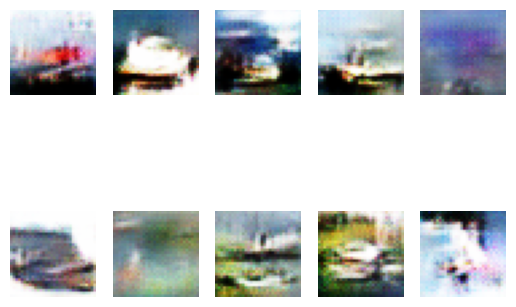

79/79 [==============================] - 5s 61ms/step - d_loss: -3.7640 - g_loss: 4.9468
Epoch 74/200
79/79 [==============================] - ETA: 0s - d_loss: -3.6427 - g_loss: 3.9205

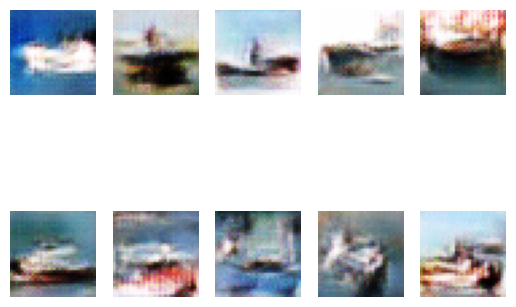

79/79 [==============================] - 5s 61ms/step - d_loss: -3.6236 - g_loss: 3.8579
Epoch 75/200
78/79 [============================>.] - ETA: 0s - d_loss: -3.7619 - g_loss: 3.8111

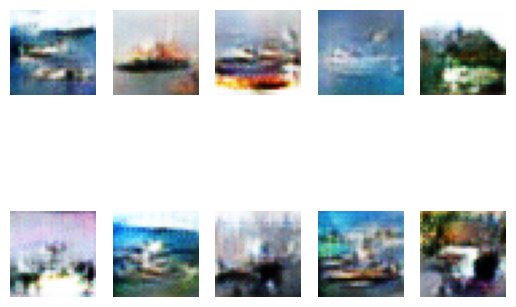

79/79 [==============================] - 4s 56ms/step - d_loss: -3.7338 - g_loss: 3.8203
Epoch 76/200
79/79 [==============================] - ETA: 0s - d_loss: -3.7353 - g_loss: 3.9657

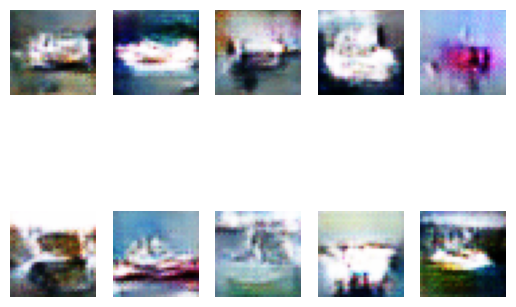

79/79 [==============================] - 4s 55ms/step - d_loss: -3.6806 - g_loss: 3.9840
Epoch 77/200
79/79 [==============================] - ETA: 0s - d_loss: -3.4304 - g_loss: 3.4426

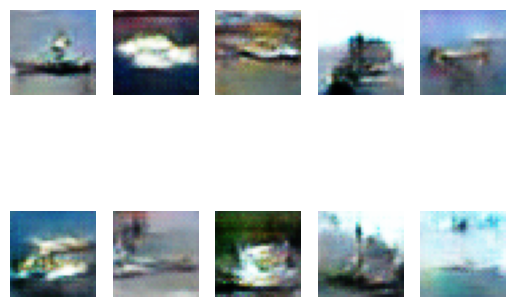

79/79 [==============================] - 5s 63ms/step - d_loss: -3.4099 - g_loss: 3.4612
Epoch 78/200
79/79 [==============================] - ETA: 0s - d_loss: -3.3370 - g_loss: 3.7789

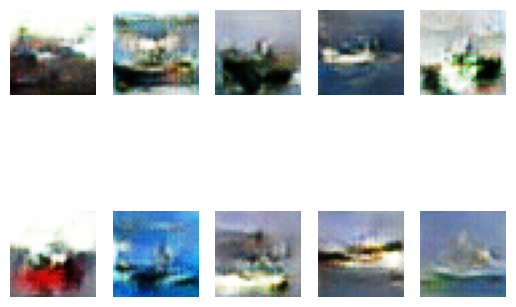

79/79 [==============================] - 5s 58ms/step - d_loss: -3.3797 - g_loss: 3.7384
Epoch 79/200
78/79 [============================>.] - ETA: 0s - d_loss: -3.5754 - g_loss: 2.8240

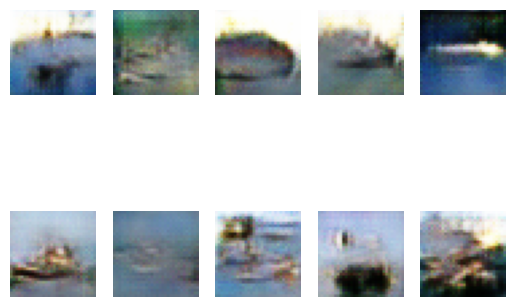

79/79 [==============================] - 5s 62ms/step - d_loss: -3.5845 - g_loss: 2.8926
Epoch 80/200
79/79 [==============================] - ETA: 0s - d_loss: -3.6476 - g_loss: 2.3216

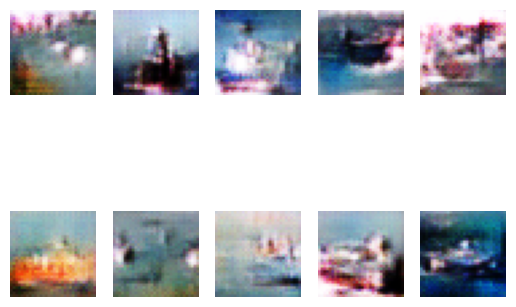

79/79 [==============================] - 5s 60ms/step - d_loss: -3.7150 - g_loss: 2.2816
Epoch 81/200
78/79 [============================>.] - ETA: 0s - d_loss: -3.1715 - g_loss: 2.3841

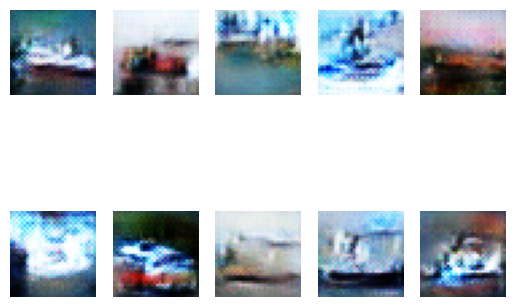

79/79 [==============================] - 5s 61ms/step - d_loss: -3.4126 - g_loss: 2.3758
Epoch 82/200
78/79 [============================>.] - ETA: 0s - d_loss: -3.4455 - g_loss: 2.1164

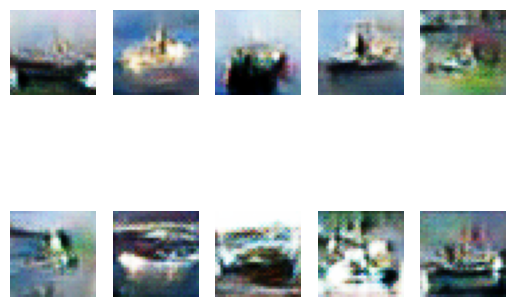

79/79 [==============================] - 4s 56ms/step - d_loss: -3.4796 - g_loss: 2.0354
Epoch 83/200
79/79 [==============================] - ETA: 0s - d_loss: -3.7809 - g_loss: 3.1466

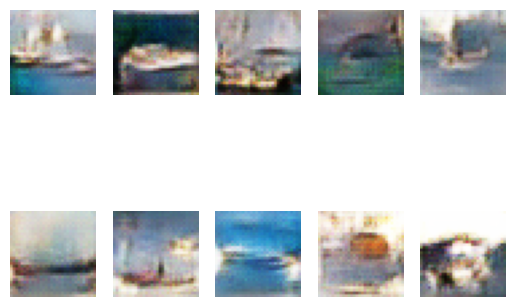

79/79 [==============================] - 4s 57ms/step - d_loss: -3.7966 - g_loss: 3.1578
Epoch 84/200
79/79 [==============================] - ETA: 0s - d_loss: -3.5784 - g_loss: 2.1096

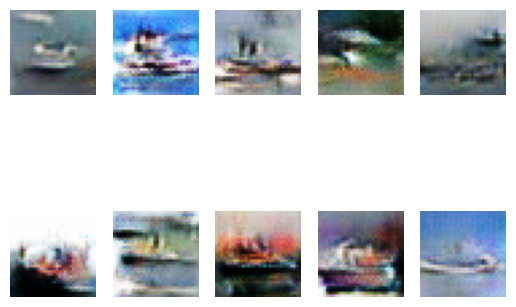

79/79 [==============================] - 5s 62ms/step - d_loss: -3.5927 - g_loss: 2.1628
Epoch 85/200
78/79 [============================>.] - ETA: 0s - d_loss: -3.3951 - g_loss: 3.0093

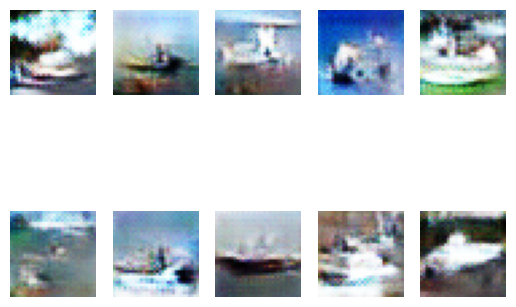

79/79 [==============================] - 5s 60ms/step - d_loss: -3.3938 - g_loss: 3.0728
Epoch 86/200
78/79 [============================>.] - ETA: 0s - d_loss: -3.4818 - g_loss: 1.8172

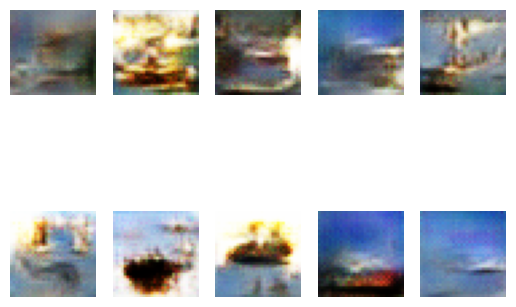

79/79 [==============================] - 5s 61ms/step - d_loss: -3.3393 - g_loss: 1.6105
Epoch 87/200
79/79 [==============================] - ETA: 0s - d_loss: -3.5303 - g_loss: 2.4956

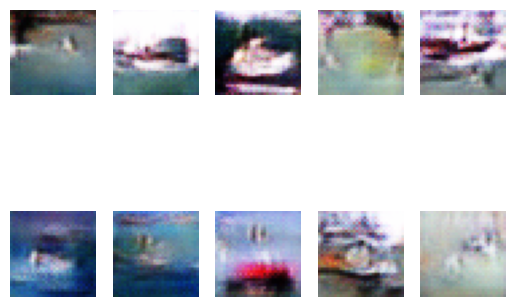

79/79 [==============================] - 5s 60ms/step - d_loss: -3.5687 - g_loss: 2.4358
Epoch 88/200
79/79 [==============================] - ETA: 0s - d_loss: -3.5871 - g_loss: 2.1644

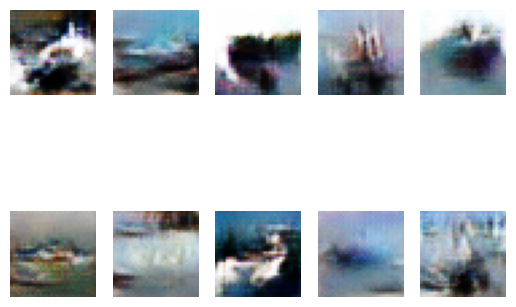

79/79 [==============================] - 5s 65ms/step - d_loss: -3.5569 - g_loss: 2.1880
Epoch 89/200
78/79 [============================>.] - ETA: 0s - d_loss: -3.7912 - g_loss: 2.1824

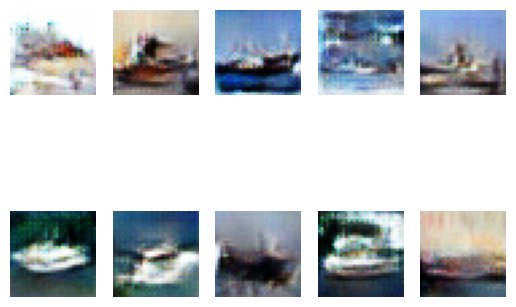

79/79 [==============================] - 5s 57ms/step - d_loss: -3.7792 - g_loss: 2.2240
Epoch 90/200
78/79 [============================>.] - ETA: 0s - d_loss: -3.3438 - g_loss: 2.3956

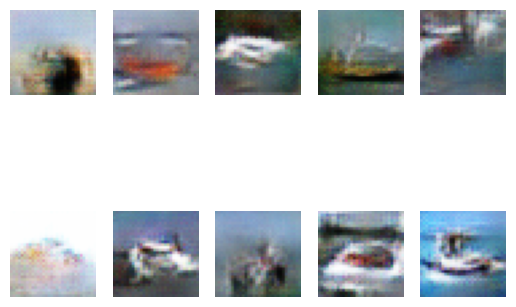

79/79 [==============================] - 4s 56ms/step - d_loss: -3.2501 - g_loss: 2.5511
Epoch 91/200
78/79 [============================>.] - ETA: 0s - d_loss: -3.3413 - g_loss: 2.0700

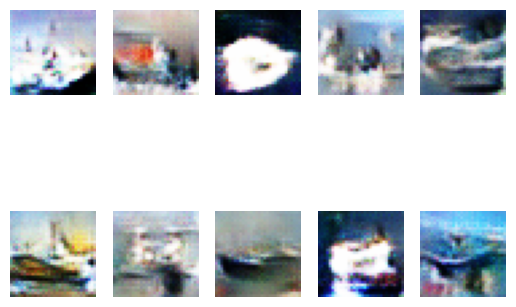

79/79 [==============================] - 5s 61ms/step - d_loss: -3.4119 - g_loss: 2.1028
Epoch 92/200
78/79 [============================>.] - ETA: 0s - d_loss: -3.8072 - g_loss: 2.0229

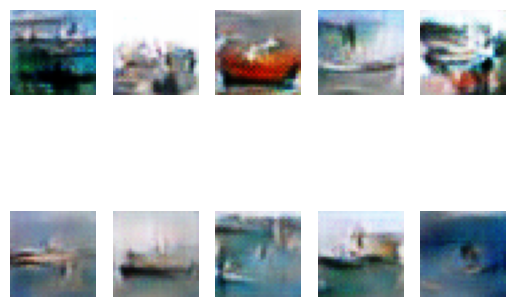

79/79 [==============================] - 5s 62ms/step - d_loss: -3.7599 - g_loss: 1.9721
Epoch 93/200
78/79 [============================>.] - ETA: 0s - d_loss: -3.5824 - g_loss: 2.6585

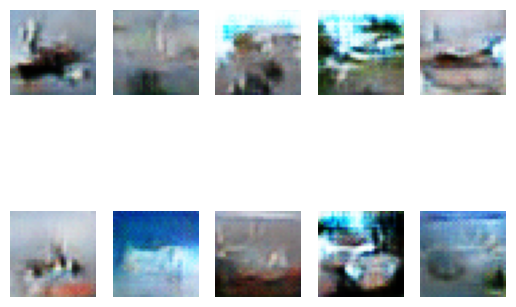

79/79 [==============================] - 5s 60ms/step - d_loss: -3.7562 - g_loss: 2.8080
Epoch 94/200
79/79 [==============================] - ETA: 0s - d_loss: -3.9997 - g_loss: 1.2321

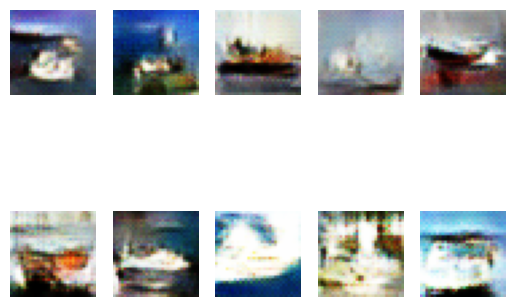

79/79 [==============================] - 5s 58ms/step - d_loss: -4.0208 - g_loss: 1.1767
Epoch 95/200
79/79 [==============================] - ETA: 0s - d_loss: -3.5508 - g_loss: 1.9602

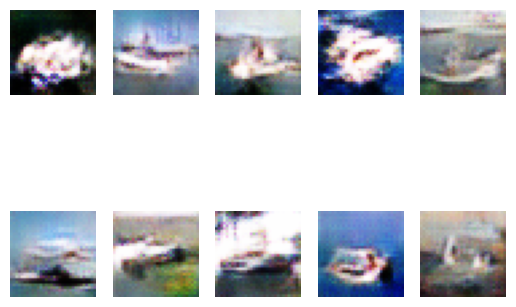

79/79 [==============================] - 5s 63ms/step - d_loss: -3.5672 - g_loss: 1.9304
Epoch 96/200
78/79 [============================>.] - ETA: 0s - d_loss: -3.6076 - g_loss: 1.8770

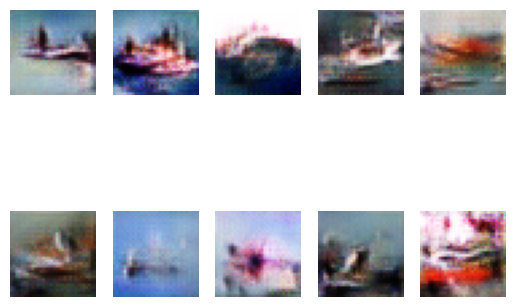

79/79 [==============================] - 5s 58ms/step - d_loss: -3.6702 - g_loss: 1.7186
Epoch 97/200
79/79 [==============================] - ETA: 0s - d_loss: -3.5708 - g_loss: 1.5236

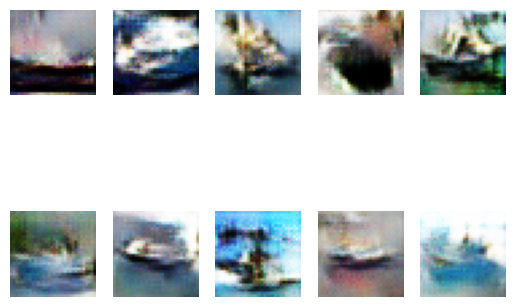

79/79 [==============================] - 4s 57ms/step - d_loss: -3.5985 - g_loss: 1.4894
Epoch 98/200
79/79 [==============================] - ETA: 0s - d_loss: -3.2501 - g_loss: 1.6051

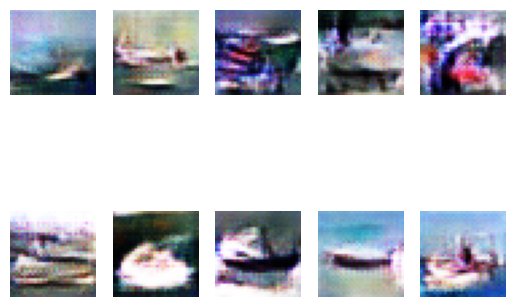

79/79 [==============================] - 5s 59ms/step - d_loss: -3.2429 - g_loss: 1.6278
Epoch 99/200
78/79 [============================>.] - ETA: 0s - d_loss: -3.4755 - g_loss: 2.4337

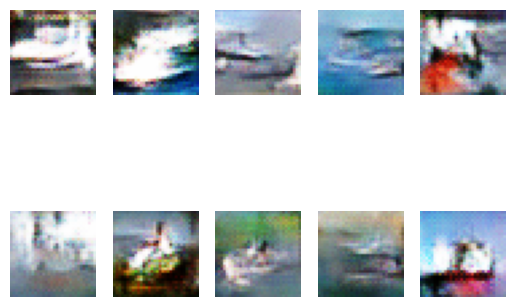

79/79 [==============================] - 5s 61ms/step - d_loss: -3.3739 - g_loss: 2.3041
Epoch 100/200
79/79 [==============================] - ETA: 0s - d_loss: -3.3986 - g_loss: 1.4617

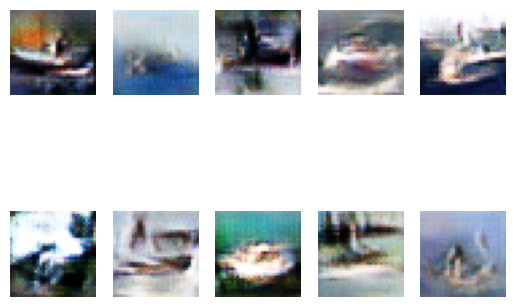

79/79 [==============================] - 5s 60ms/step - d_loss: -3.3696 - g_loss: 1.4241
Epoch 101/200
79/79 [==============================] - ETA: 0s - d_loss: -3.1428 - g_loss: 1.8007

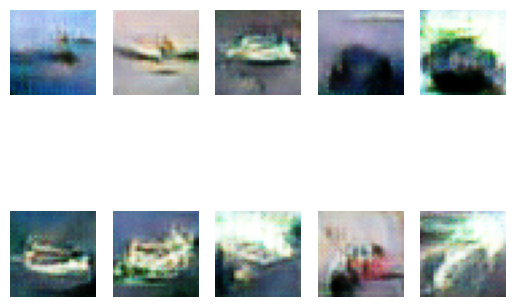

79/79 [==============================] - 4s 56ms/step - d_loss: -3.1471 - g_loss: 1.8181
Epoch 102/200
79/79 [==============================] - ETA: 0s - d_loss: -3.2754 - g_loss: 2.6396

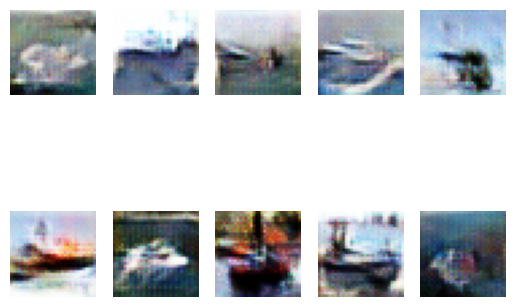

79/79 [==============================] - 5s 62ms/step - d_loss: -3.2138 - g_loss: 2.6490
Epoch 103/200
78/79 [============================>.] - ETA: 0s - d_loss: -3.2989 - g_loss: 3.5505

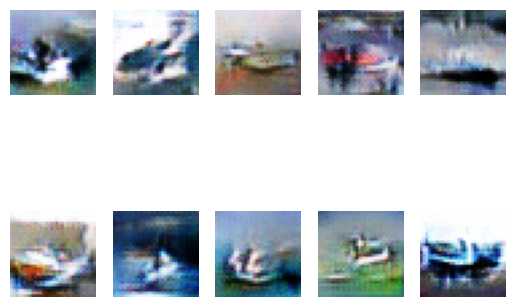

79/79 [==============================] - 5s 59ms/step - d_loss: -3.2349 - g_loss: 3.5014
Epoch 104/200
78/79 [============================>.] - ETA: 0s - d_loss: -3.2814 - g_loss: 3.2720

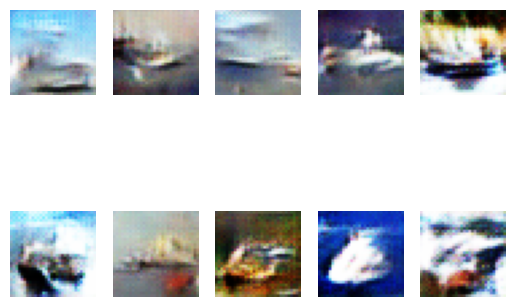

79/79 [==============================] - 4s 56ms/step - d_loss: -3.2461 - g_loss: 3.2418
Epoch 105/200
79/79 [==============================] - ETA: 0s - d_loss: -3.2015 - g_loss: 2.8279

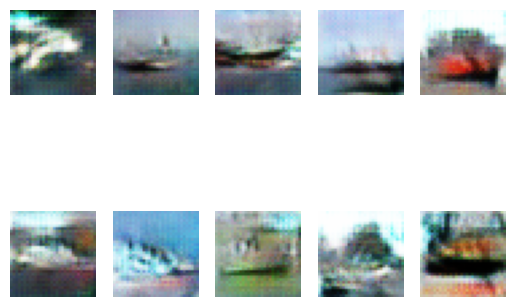

79/79 [==============================] - 5s 57ms/step - d_loss: -3.2355 - g_loss: 2.9079
Epoch 106/200
79/79 [==============================] - ETA: 0s - d_loss: -3.2517 - g_loss: 2.8887

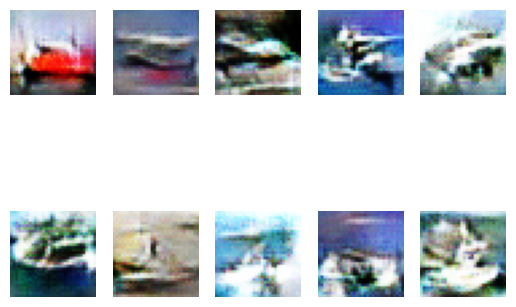

79/79 [==============================] - 5s 67ms/step - d_loss: -3.2422 - g_loss: 2.8536
Epoch 107/200
78/79 [============================>.] - ETA: 0s - d_loss: -3.0883 - g_loss: 3.0737

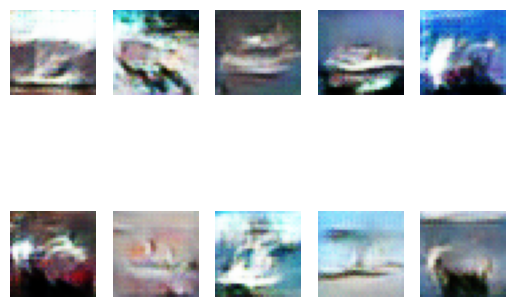

79/79 [==============================] - 4s 54ms/step - d_loss: -3.1507 - g_loss: 3.0633
Epoch 108/200
78/79 [============================>.] - ETA: 0s - d_loss: -3.0390 - g_loss: 2.4562

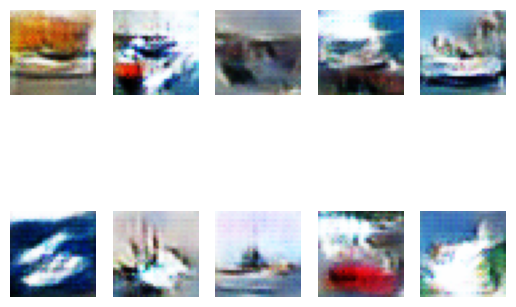

79/79 [==============================] - 4s 56ms/step - d_loss: -3.0854 - g_loss: 2.4811
Epoch 109/200
79/79 [==============================] - ETA: 0s - d_loss: -3.1030 - g_loss: 2.6857

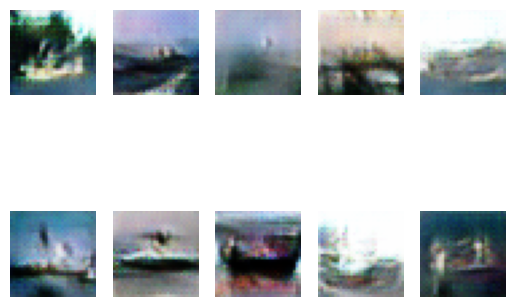

79/79 [==============================] - 5s 62ms/step - d_loss: -3.1428 - g_loss: 2.7663
Epoch 110/200
78/79 [============================>.] - ETA: 0s - d_loss: -3.0541 - g_loss: 4.1142

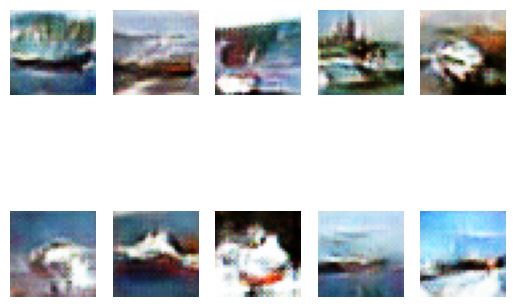

79/79 [==============================] - 5s 58ms/step - d_loss: -3.0358 - g_loss: 4.0655
Epoch 111/200
78/79 [============================>.] - ETA: 0s - d_loss: -3.0848 - g_loss: 3.1458

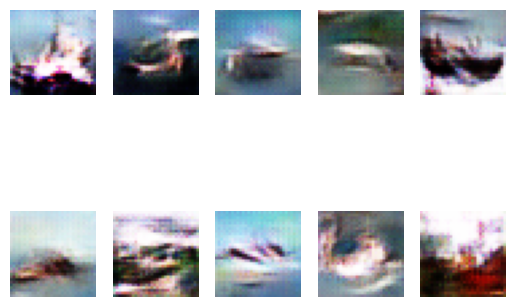

79/79 [==============================] - 4s 55ms/step - d_loss: -2.9960 - g_loss: 3.1510
Epoch 112/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.9533 - g_loss: 3.0951

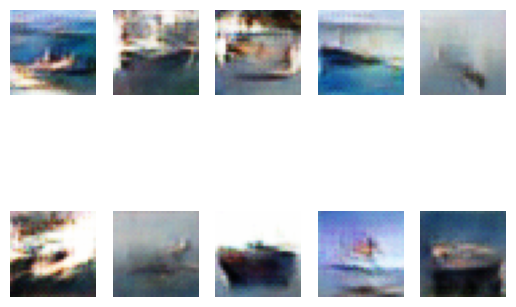

79/79 [==============================] - 5s 57ms/step - d_loss: -2.9184 - g_loss: 3.1308
Epoch 113/200
79/79 [==============================] - ETA: 0s - d_loss: -2.8502 - g_loss: 3.3707

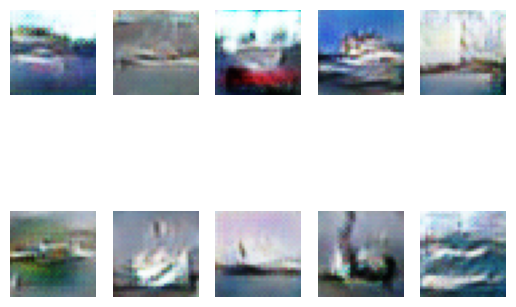

79/79 [==============================] - 5s 64ms/step - d_loss: -2.8244 - g_loss: 3.3668
Epoch 114/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.8677 - g_loss: 3.9739

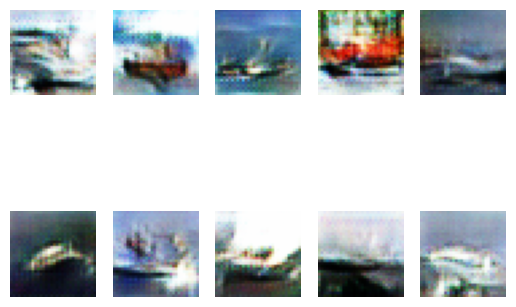

79/79 [==============================] - 5s 57ms/step - d_loss: -2.8549 - g_loss: 3.8895
Epoch 115/200
79/79 [==============================] - ETA: 0s - d_loss: -2.9449 - g_loss: 3.6477

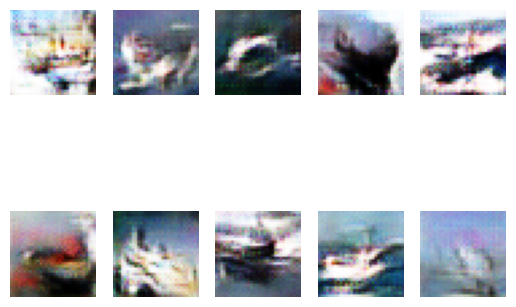

79/79 [==============================] - 4s 56ms/step - d_loss: -2.9871 - g_loss: 3.6935
Epoch 116/200
79/79 [==============================] - ETA: 0s - d_loss: -2.7547 - g_loss: 4.3467

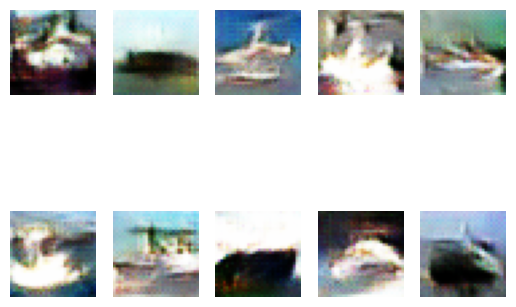

79/79 [==============================] - 5s 58ms/step - d_loss: -2.7404 - g_loss: 4.2773
Epoch 117/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.9223 - g_loss: 4.3313

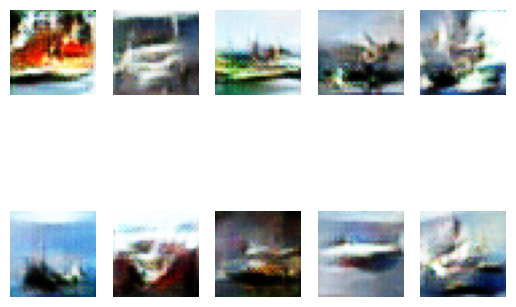

79/79 [==============================] - 5s 60ms/step - d_loss: -2.9303 - g_loss: 4.4236
Epoch 118/200
79/79 [==============================] - ETA: 0s - d_loss: -2.8284 - g_loss: 3.8026

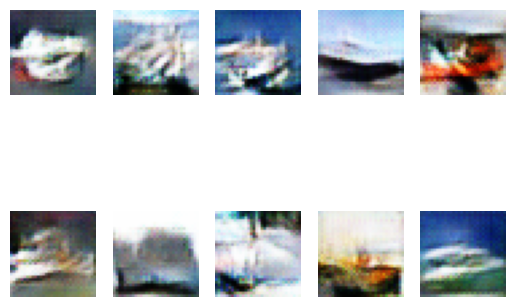

79/79 [==============================] - 4s 56ms/step - d_loss: -2.8402 - g_loss: 3.7792
Epoch 119/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.6006 - g_loss: 4.0134

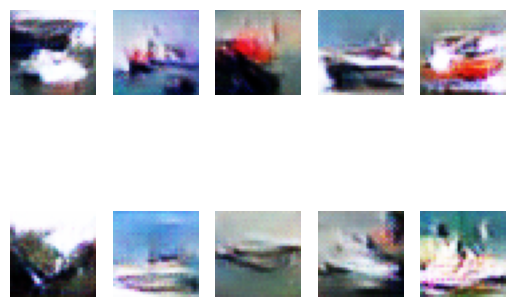

79/79 [==============================] - 4s 56ms/step - d_loss: -2.5360 - g_loss: 4.0304
Epoch 120/200
79/79 [==============================] - ETA: 0s - d_loss: -2.6780 - g_loss: 3.7287

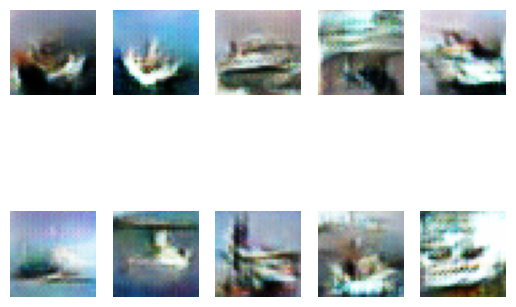

79/79 [==============================] - 5s 68ms/step - d_loss: -2.6781 - g_loss: 3.7116
Epoch 121/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.6464 - g_loss: 4.4175

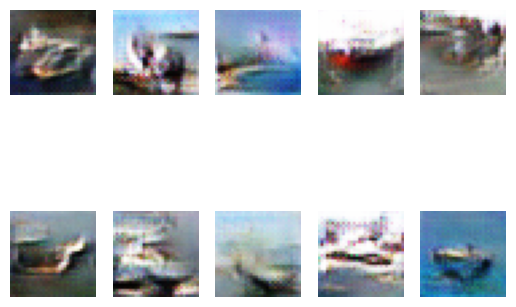

79/79 [==============================] - 5s 57ms/step - d_loss: -2.7168 - g_loss: 4.4630
Epoch 122/200
79/79 [==============================] - ETA: 0s - d_loss: -2.6632 - g_loss: 3.8611

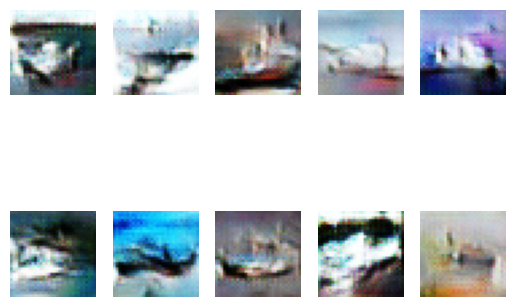

79/79 [==============================] - 4s 56ms/step - d_loss: -2.6817 - g_loss: 3.8939
Epoch 123/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.6640 - g_loss: 5.4779

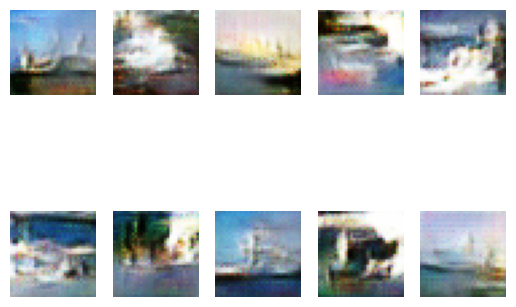

79/79 [==============================] - 4s 57ms/step - d_loss: -2.7120 - g_loss: 5.4334
Epoch 124/200
79/79 [==============================] - ETA: 0s - d_loss: -2.6387 - g_loss: 4.1466

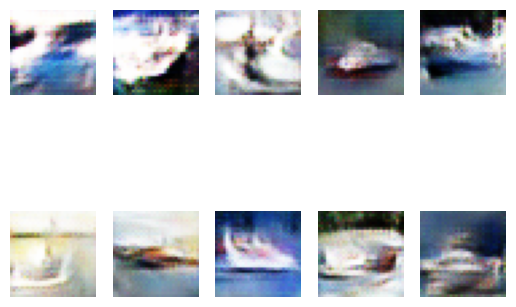

79/79 [==============================] - 5s 62ms/step - d_loss: -2.6902 - g_loss: 4.0887
Epoch 125/200
79/79 [==============================] - ETA: 0s - d_loss: -2.6353 - g_loss: 4.3114

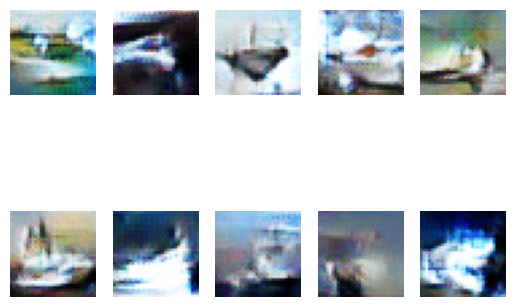

79/79 [==============================] - 4s 55ms/step - d_loss: -2.4987 - g_loss: 4.3778
Epoch 126/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.6635 - g_loss: 3.1325

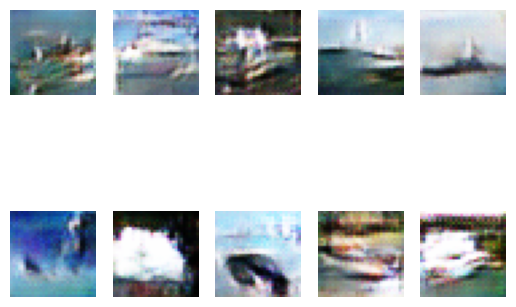

79/79 [==============================] - 4s 55ms/step - d_loss: -2.2831 - g_loss: 3.2022
Epoch 127/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.6000 - g_loss: 4.8530

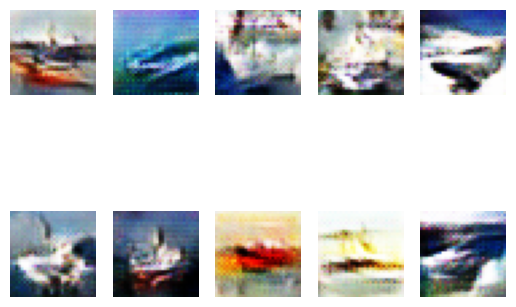

79/79 [==============================] - 5s 65ms/step - d_loss: -2.3218 - g_loss: 4.7736
Epoch 128/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.5526 - g_loss: 3.7801

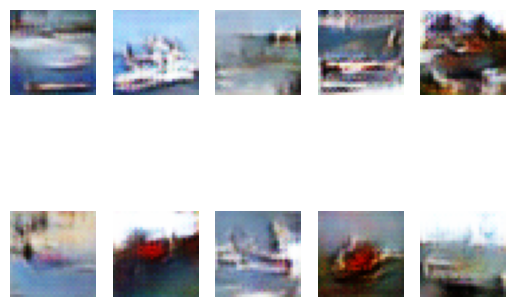

79/79 [==============================] - 5s 61ms/step - d_loss: -2.5964 - g_loss: 3.7860
Epoch 129/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.5720 - g_loss: 3.8329

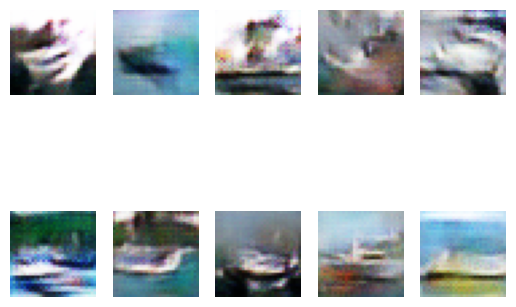

79/79 [==============================] - 4s 54ms/step - d_loss: -2.5991 - g_loss: 3.8319
Epoch 130/200
79/79 [==============================] - ETA: 0s - d_loss: -2.6087 - g_loss: 4.9083

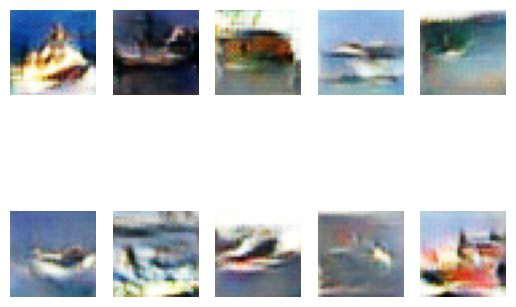

79/79 [==============================] - 4s 57ms/step - d_loss: -2.6438 - g_loss: 4.9246
Epoch 131/200
79/79 [==============================] - ETA: 0s - d_loss: -2.5851 - g_loss: 5.0299

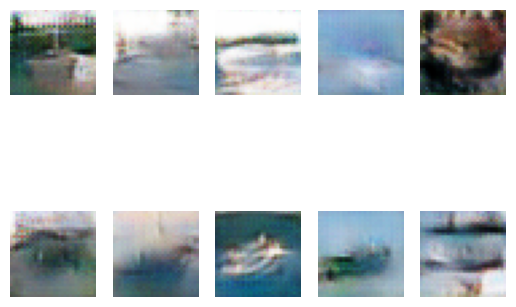

79/79 [==============================] - 5s 61ms/step - d_loss: -2.5616 - g_loss: 5.0361
Epoch 132/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.5013 - g_loss: 5.3281

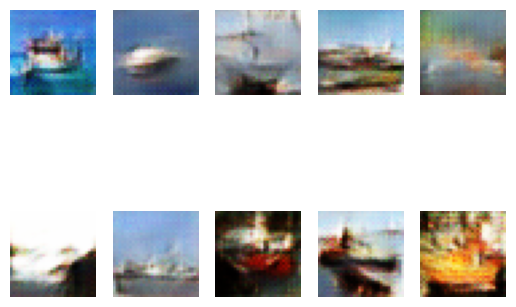

79/79 [==============================] - 5s 58ms/step - d_loss: -2.5475 - g_loss: 5.2505
Epoch 133/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.5647 - g_loss: 5.6861

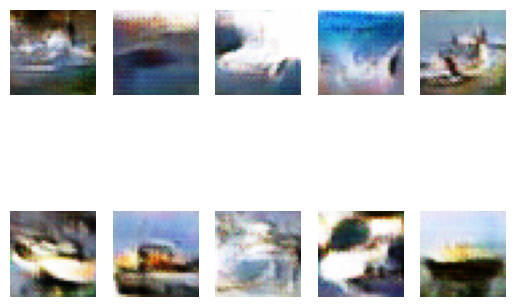

79/79 [==============================] - 4s 55ms/step - d_loss: -2.4877 - g_loss: 5.6889
Epoch 134/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.3184 - g_loss: 5.7346

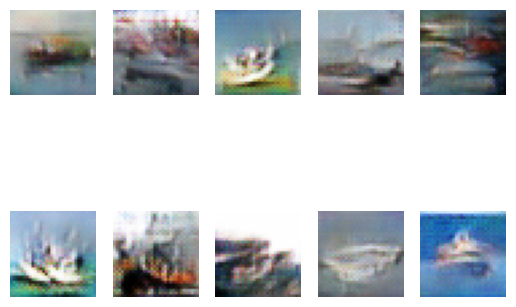

79/79 [==============================] - 5s 63ms/step - d_loss: -2.1706 - g_loss: 5.6928
Epoch 135/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.2801 - g_loss: 6.3235

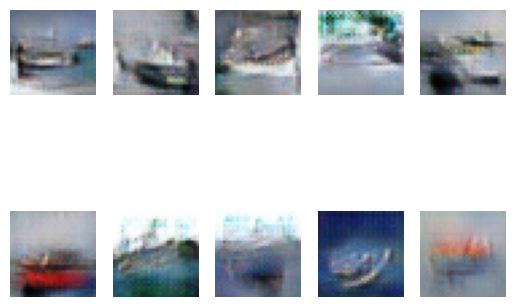

79/79 [==============================] - 5s 62ms/step - d_loss: -2.2691 - g_loss: 6.3743
Epoch 136/200
79/79 [==============================] - ETA: 0s - d_loss: -2.4642 - g_loss: 5.4838

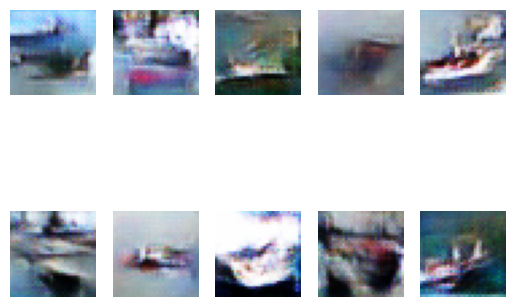

79/79 [==============================] - 4s 57ms/step - d_loss: -2.4281 - g_loss: 5.5323
Epoch 137/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.4927 - g_loss: 5.4168

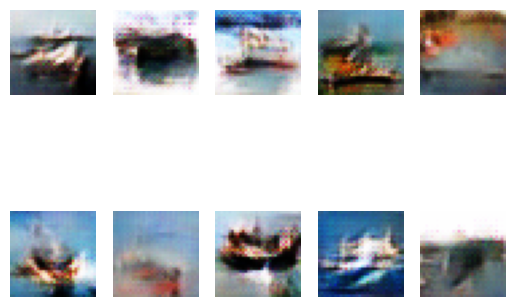

79/79 [==============================] - 4s 55ms/step - d_loss: -2.4737 - g_loss: 5.2221
Epoch 138/200
79/79 [==============================] - ETA: 0s - d_loss: -2.4722 - g_loss: 6.0446

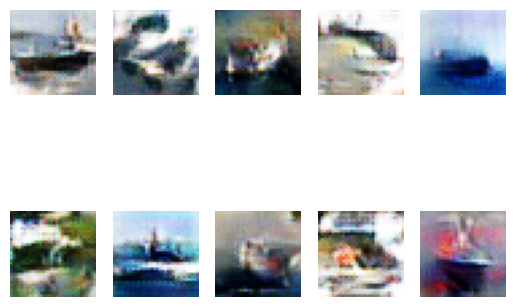

79/79 [==============================] - 5s 61ms/step - d_loss: -2.5017 - g_loss: 6.0982
Epoch 139/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.4071 - g_loss: 5.1848

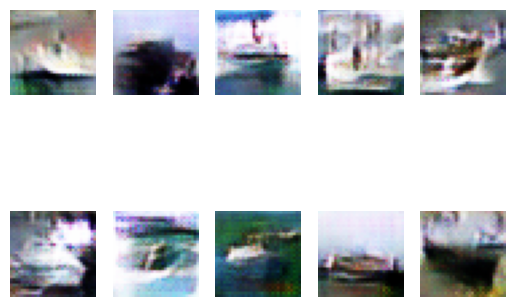

79/79 [==============================] - 4s 57ms/step - d_loss: -2.5234 - g_loss: 5.1727
Epoch 140/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.4814 - g_loss: 5.5249

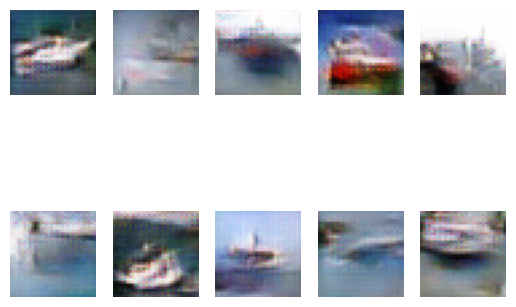

79/79 [==============================] - 5s 58ms/step - d_loss: -2.1946 - g_loss: 5.3400
Epoch 141/200
79/79 [==============================] - ETA: 0s - d_loss: -2.5026 - g_loss: 5.0758

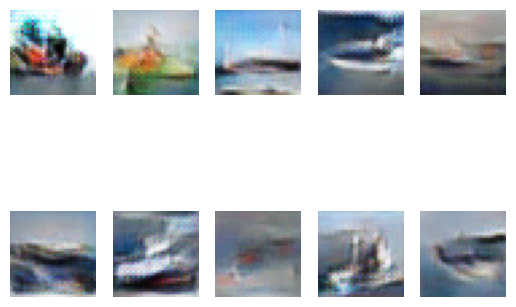

79/79 [==============================] - 5s 64ms/step - d_loss: -2.5148 - g_loss: 5.0779
Epoch 142/200
79/79 [==============================] - ETA: 0s - d_loss: -2.3926 - g_loss: 4.7434

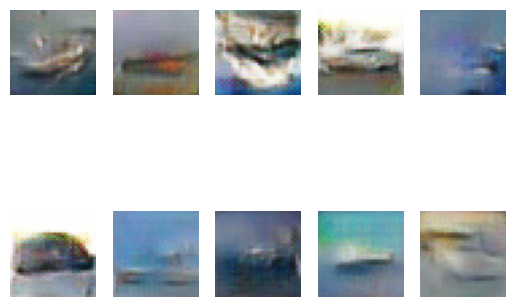

79/79 [==============================] - 5s 61ms/step - d_loss: -2.4542 - g_loss: 4.6918
Epoch 143/200
79/79 [==============================] - ETA: 0s - d_loss: -2.5837 - g_loss: 5.3044

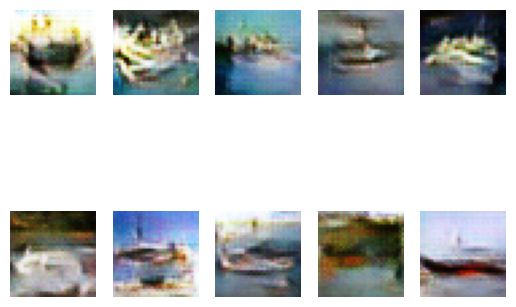

79/79 [==============================] - 4s 57ms/step - d_loss: -2.4897 - g_loss: 5.2241
Epoch 144/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.2464 - g_loss: 5.0841

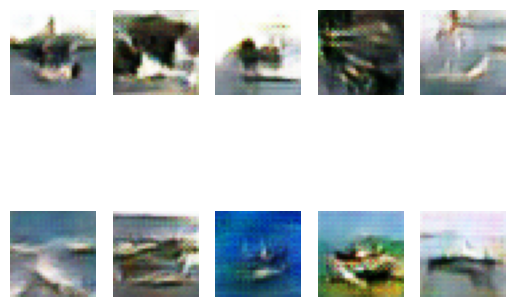

79/79 [==============================] - 4s 56ms/step - d_loss: -2.2794 - g_loss: 5.0229
Epoch 145/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.2415 - g_loss: 5.2599

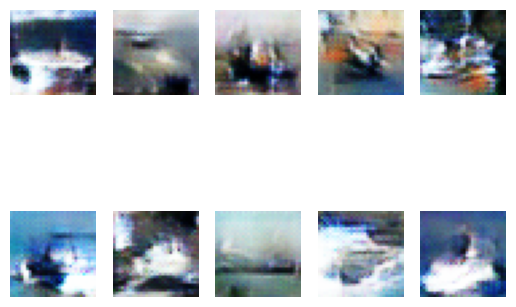

79/79 [==============================] - 5s 60ms/step - d_loss: -2.3331 - g_loss: 5.3886
Epoch 146/200
79/79 [==============================] - ETA: 0s - d_loss: -2.2964 - g_loss: 5.4975

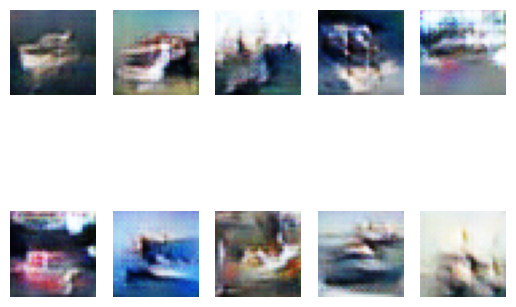

79/79 [==============================] - 5s 59ms/step - d_loss: -2.3042 - g_loss: 5.5611
Epoch 147/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.2368 - g_loss: 5.2359

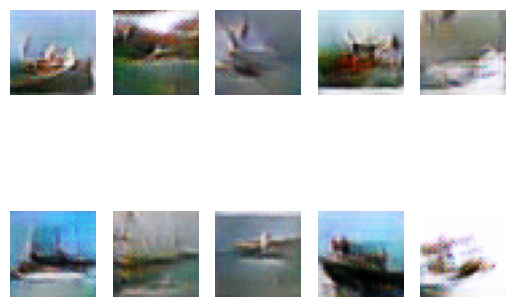

79/79 [==============================] - 4s 55ms/step - d_loss: -2.1197 - g_loss: 5.2532
Epoch 148/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.2543 - g_loss: 5.4409

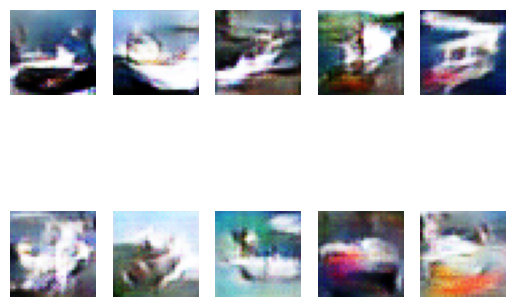

79/79 [==============================] - 5s 61ms/step - d_loss: -2.3079 - g_loss: 5.4637
Epoch 149/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.1251 - g_loss: 5.6694

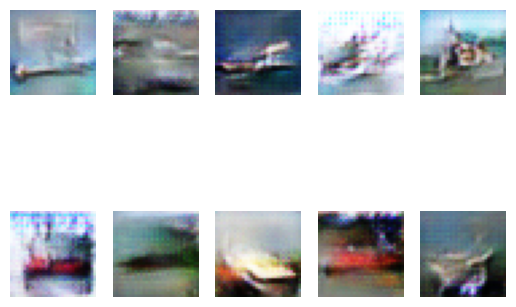

79/79 [==============================] - 5s 65ms/step - d_loss: -2.1198 - g_loss: 5.7655
Epoch 150/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.1095 - g_loss: 6.4492

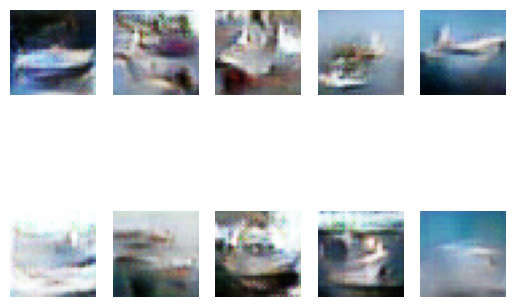

79/79 [==============================] - 4s 57ms/step - d_loss: -2.0989 - g_loss: 6.3935
Epoch 151/200
79/79 [==============================] - ETA: 0s - d_loss: -2.1331 - g_loss: 5.7905

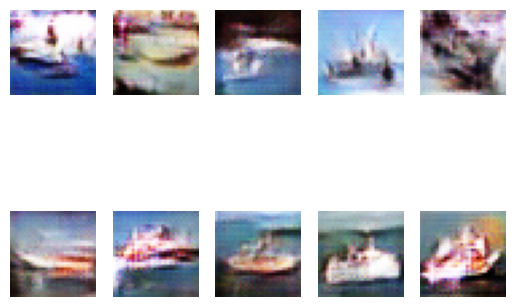

79/79 [==============================] - 4s 57ms/step - d_loss: -2.0226 - g_loss: 5.7819
Epoch 152/200
79/79 [==============================] - ETA: 0s - d_loss: -2.2491 - g_loss: 6.1454

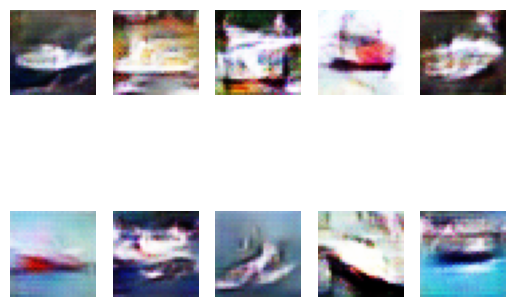

79/79 [==============================] - 5s 59ms/step - d_loss: -2.2849 - g_loss: 6.0914
Epoch 153/200
79/79 [==============================] - ETA: 0s - d_loss: -2.0609 - g_loss: 5.6262

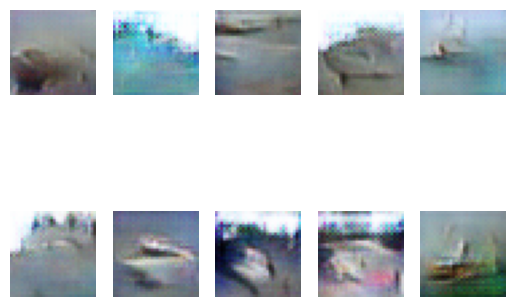

79/79 [==============================] - 5s 62ms/step - d_loss: -2.0496 - g_loss: 5.6306
Epoch 154/200
79/79 [==============================] - ETA: 0s - d_loss: -2.2578 - g_loss: 5.6999

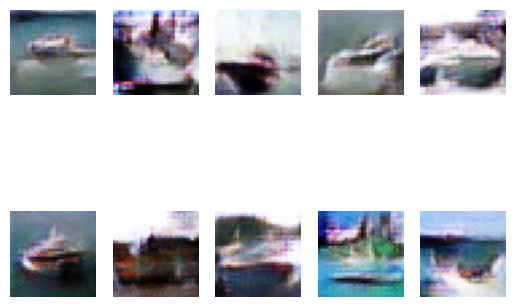

79/79 [==============================] - 4s 56ms/step - d_loss: -2.2286 - g_loss: 5.6697
Epoch 155/200
79/79 [==============================] - ETA: 0s - d_loss: -1.9725 - g_loss: 4.9966

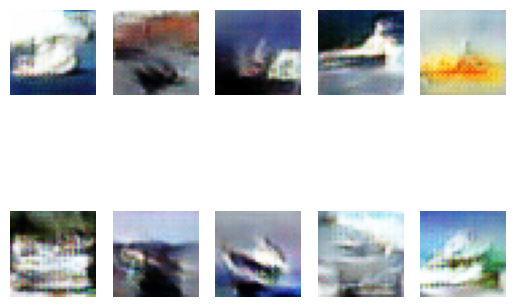

79/79 [==============================] - 5s 61ms/step - d_loss: -1.9433 - g_loss: 4.9390
Epoch 156/200
79/79 [==============================] - ETA: 0s - d_loss: -1.9764 - g_loss: 5.8696

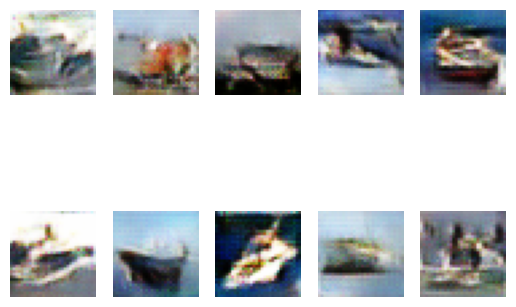

79/79 [==============================] - 5s 64ms/step - d_loss: -1.9449 - g_loss: 5.8182
Epoch 157/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.3099 - g_loss: 5.8535

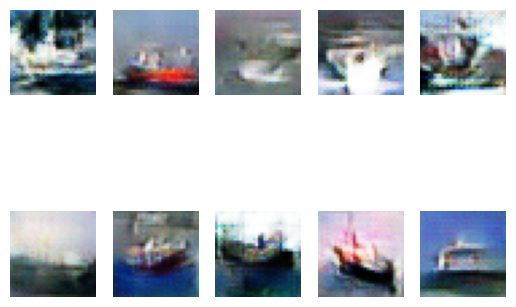

79/79 [==============================] - 5s 58ms/step - d_loss: -2.1874 - g_loss: 5.7889
Epoch 158/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.0320 - g_loss: 4.9529

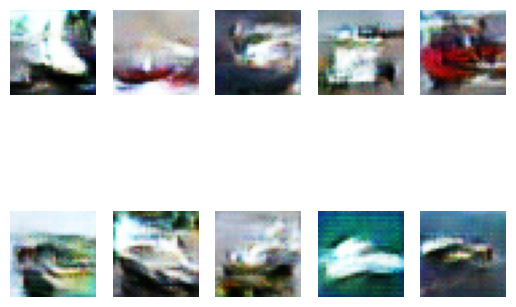

79/79 [==============================] - 4s 55ms/step - d_loss: -1.9421 - g_loss: 5.0560
Epoch 159/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.0896 - g_loss: 6.3864

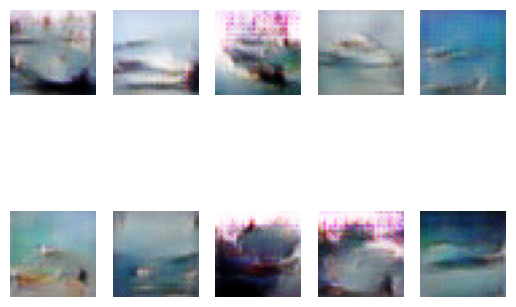

79/79 [==============================] - 5s 57ms/step - d_loss: -2.0791 - g_loss: 6.2839
Epoch 160/200
79/79 [==============================] - ETA: 0s - d_loss: -2.0255 - g_loss: 5.4398

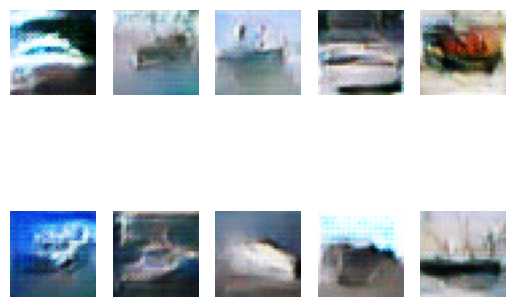

79/79 [==============================] - 5s 62ms/step - d_loss: -2.0468 - g_loss: 5.5049
Epoch 161/200
79/79 [==============================] - ETA: 0s - d_loss: -1.7901 - g_loss: 7.0193

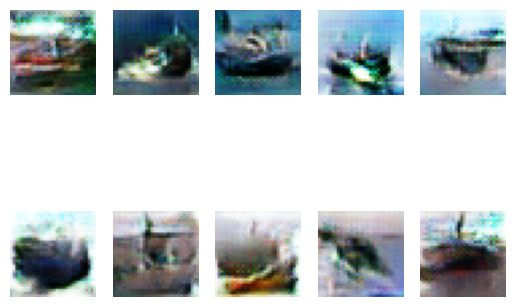

79/79 [==============================] - 4s 57ms/step - d_loss: -1.7008 - g_loss: 7.0618
Epoch 162/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.0660 - g_loss: 6.0576

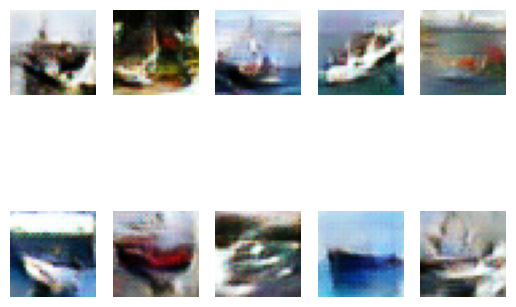

79/79 [==============================] - 5s 60ms/step - d_loss: -2.0730 - g_loss: 5.9820
Epoch 163/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.0055 - g_loss: 5.5992

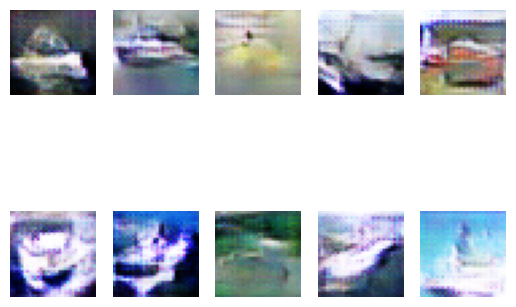

79/79 [==============================] - 5s 62ms/step - d_loss: -1.6427 - g_loss: 5.7025
Epoch 164/200
79/79 [==============================] - ETA: 0s - d_loss: -2.1137 - g_loss: 5.9342

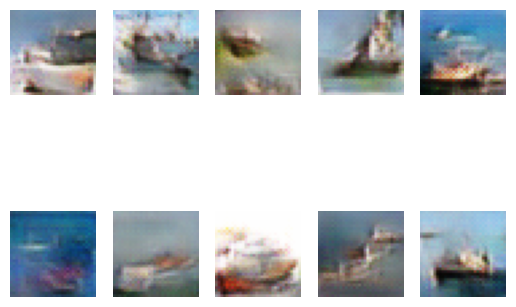

79/79 [==============================] - 5s 57ms/step - d_loss: -2.0823 - g_loss: 5.9376
Epoch 165/200
78/79 [============================>.] - ETA: 0s - d_loss: -1.9052 - g_loss: 6.1252

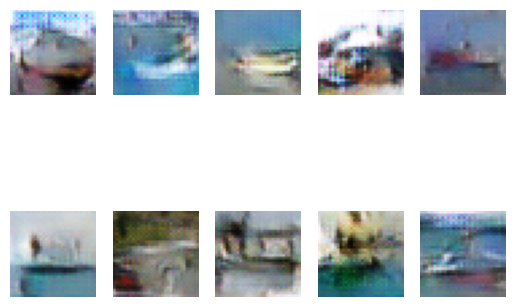

79/79 [==============================] - 4s 56ms/step - d_loss: -1.8383 - g_loss: 6.1948
Epoch 166/200
79/79 [==============================] - ETA: 0s - d_loss: -2.1854 - g_loss: 5.2014

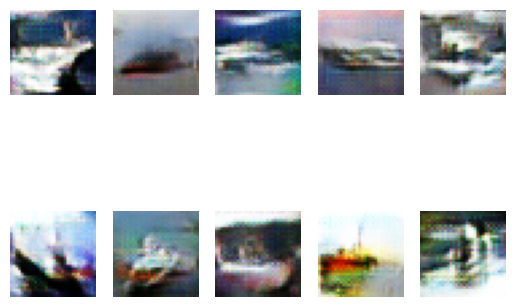

79/79 [==============================] - 5s 59ms/step - d_loss: -2.2713 - g_loss: 5.1780
Epoch 167/200
79/79 [==============================] - ETA: 0s - d_loss: -2.1489 - g_loss: 4.9823

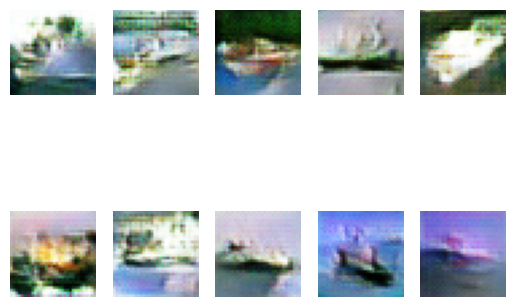

79/79 [==============================] - 5s 63ms/step - d_loss: -2.1558 - g_loss: 4.9668
Epoch 168/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.0365 - g_loss: 5.6054

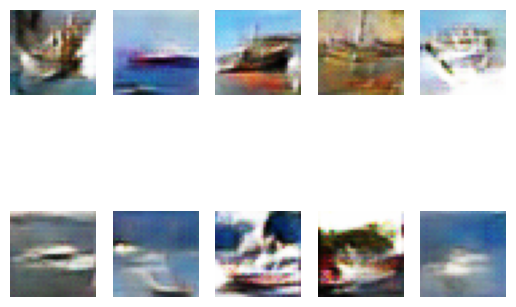

79/79 [==============================] - 4s 57ms/step - d_loss: -2.0665 - g_loss: 5.5961
Epoch 169/200
79/79 [==============================] - ETA: 0s - d_loss: -2.1582 - g_loss: 6.7116

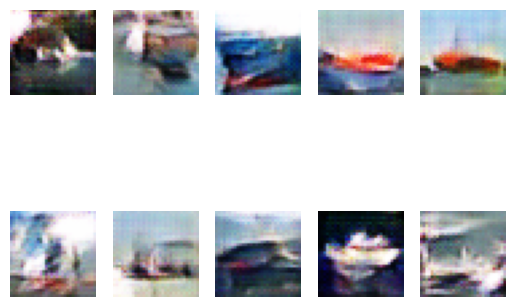

79/79 [==============================] - 5s 61ms/step - d_loss: -2.2107 - g_loss: 6.6974
Epoch 170/200
79/79 [==============================] - ETA: 0s - d_loss: -1.8921 - g_loss: 6.4115

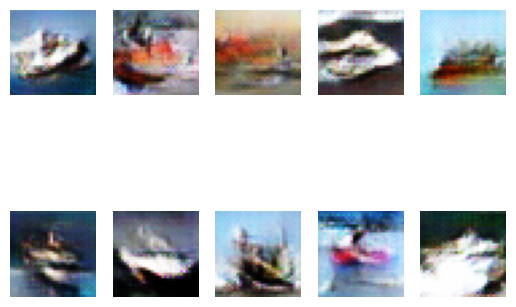

79/79 [==============================] - 5s 61ms/step - d_loss: -1.9447 - g_loss: 6.4233
Epoch 171/200
79/79 [==============================] - ETA: 0s - d_loss: -1.9577 - g_loss: 7.3241

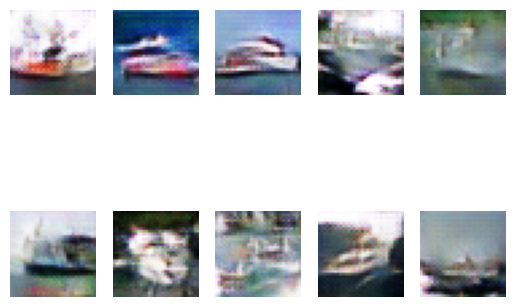

79/79 [==============================] - 5s 61ms/step - d_loss: -1.9818 - g_loss: 7.2949
Epoch 172/200
79/79 [==============================] - ETA: 0s - d_loss: -2.1683 - g_loss: 7.5045

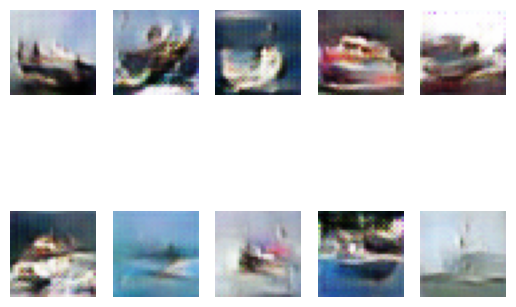

79/79 [==============================] - 4s 57ms/step - d_loss: -2.1876 - g_loss: 7.4865
Epoch 173/200
78/79 [============================>.] - ETA: 0s - d_loss: -1.8032 - g_loss: 7.0925

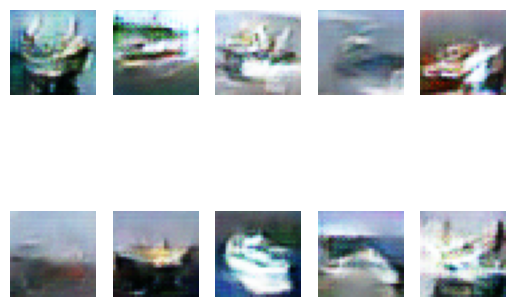

79/79 [==============================] - 4s 57ms/step - d_loss: -1.7170 - g_loss: 7.0847
Epoch 174/200
78/79 [============================>.] - ETA: 0s - d_loss: -1.9920 - g_loss: 7.0379

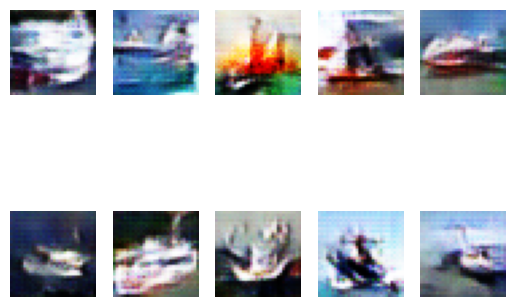

79/79 [==============================] - 5s 62ms/step - d_loss: -2.0425 - g_loss: 7.0967
Epoch 175/200
79/79 [==============================] - ETA: 0s - d_loss: -1.7680 - g_loss: 5.9438

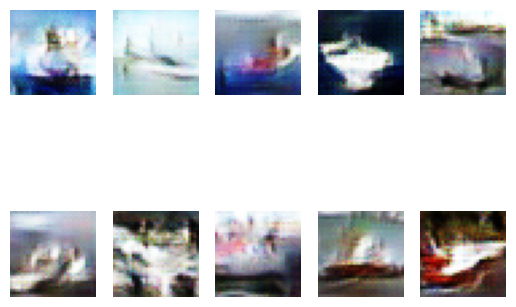

79/79 [==============================] - 5s 58ms/step - d_loss: -1.7292 - g_loss: 5.9530
Epoch 176/200
78/79 [============================>.] - ETA: 0s - d_loss: -1.9390 - g_loss: 7.0625

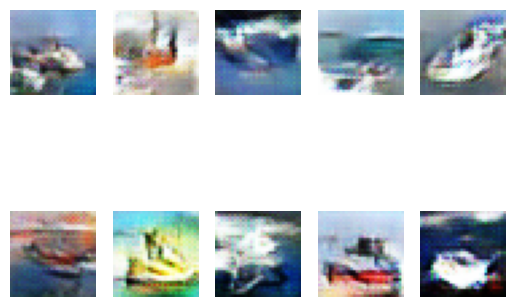

79/79 [==============================] - 5s 61ms/step - d_loss: -1.9948 - g_loss: 7.0290
Epoch 177/200
78/79 [============================>.] - ETA: 0s - d_loss: -1.8022 - g_loss: 6.6100

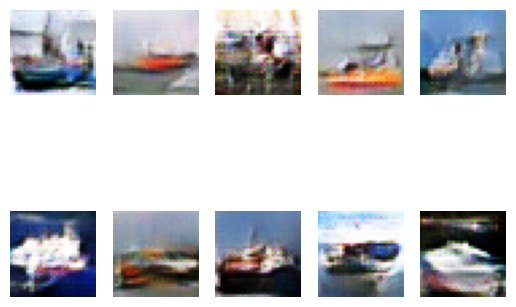

79/79 [==============================] - 5s 58ms/step - d_loss: -1.7732 - g_loss: 6.5728
Epoch 178/200
79/79 [==============================] - ETA: 0s - d_loss: -1.9223 - g_loss: 6.6391

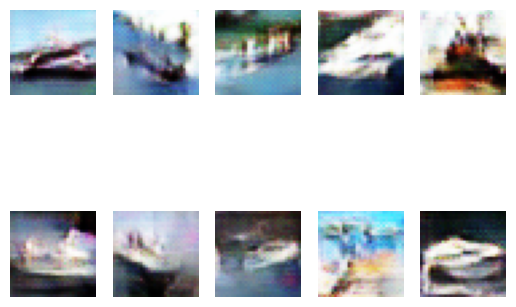

79/79 [==============================] - 5s 60ms/step - d_loss: -1.9209 - g_loss: 6.6656
Epoch 179/200
79/79 [==============================] - ETA: 0s - d_loss: -1.9547 - g_loss: 7.6434

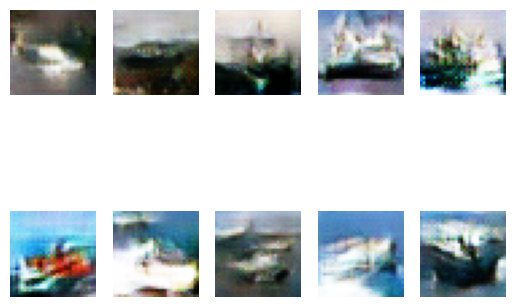

79/79 [==============================] - 4s 56ms/step - d_loss: -1.9193 - g_loss: 7.6721
Epoch 180/200
78/79 [============================>.] - ETA: 0s - d_loss: -1.8487 - g_loss: 6.2626

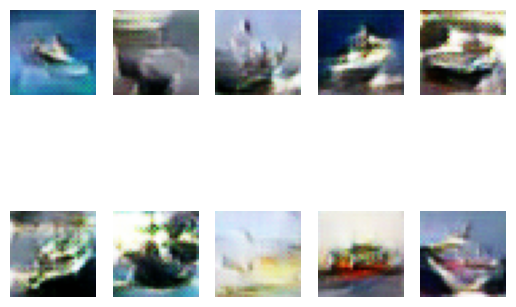

79/79 [==============================] - 4s 56ms/step - d_loss: -1.9079 - g_loss: 6.3690
Epoch 181/200
79/79 [==============================] - ETA: 0s - d_loss: -1.7923 - g_loss: 6.2878

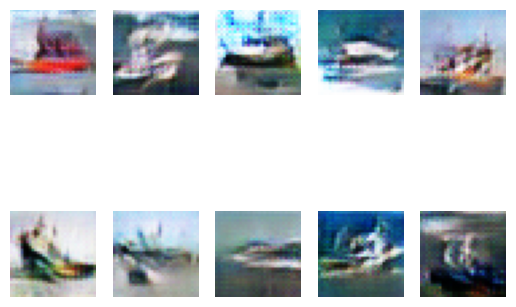

79/79 [==============================] - 5s 60ms/step - d_loss: -1.6743 - g_loss: 6.3221
Epoch 182/200
78/79 [============================>.] - ETA: 0s - d_loss: -1.7317 - g_loss: 6.1899

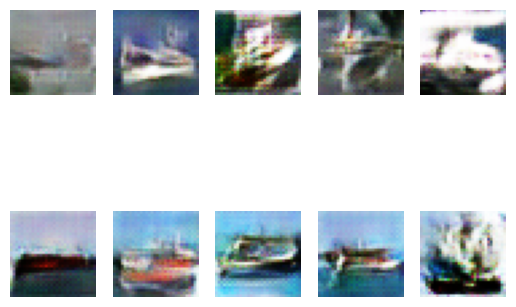

79/79 [==============================] - 5s 59ms/step - d_loss: -1.6699 - g_loss: 6.3197
Epoch 183/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.0285 - g_loss: 6.8962

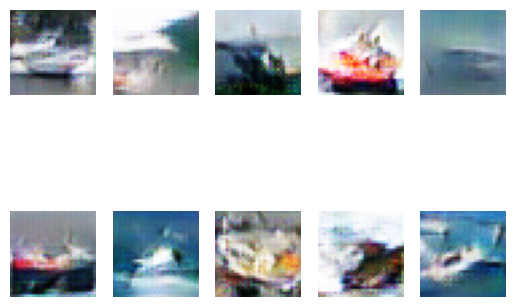

79/79 [==============================] - 5s 61ms/step - d_loss: -1.9979 - g_loss: 6.9119
Epoch 184/200
79/79 [==============================] - ETA: 0s - d_loss: -1.9924 - g_loss: 6.5998

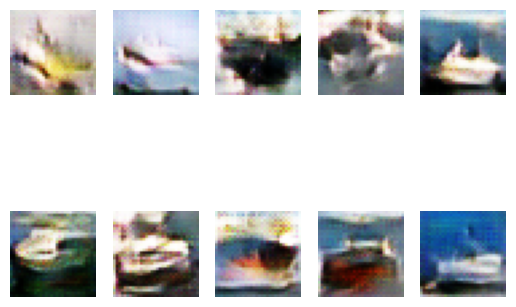

79/79 [==============================] - 5s 57ms/step - d_loss: -2.0423 - g_loss: 6.6146
Epoch 185/200
79/79 [==============================] - ETA: 0s - d_loss: -2.0044 - g_loss: 6.6889

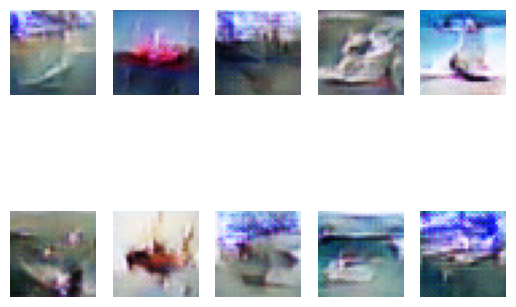

79/79 [==============================] - 5s 65ms/step - d_loss: -2.0769 - g_loss: 6.6947
Epoch 186/200
78/79 [============================>.] - ETA: 0s - d_loss: -2.0761 - g_loss: 6.3414

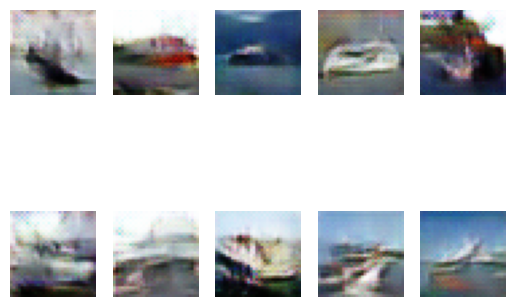

79/79 [==============================] - 4s 55ms/step - d_loss: -1.9900 - g_loss: 6.4018
Epoch 187/200
79/79 [==============================] - ETA: 0s - d_loss: -1.9392 - g_loss: 6.2218

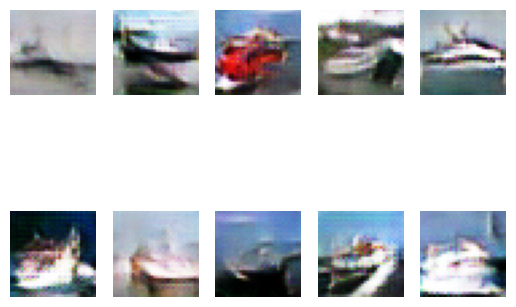

79/79 [==============================] - 4s 56ms/step - d_loss: -1.9332 - g_loss: 6.2623
Epoch 188/200
79/79 [==============================] - ETA: 0s - d_loss: -1.9071 - g_loss: 6.6831

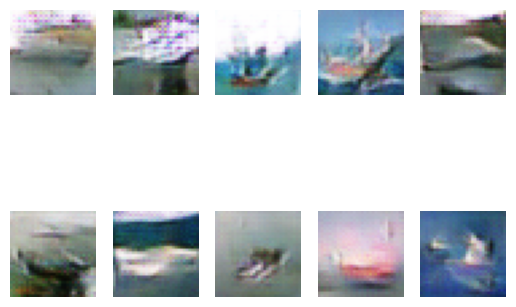

79/79 [==============================] - 5s 61ms/step - d_loss: -1.7889 - g_loss: 6.6557
Epoch 189/200
78/79 [============================>.] - ETA: 0s - d_loss: -1.7827 - g_loss: 5.9121

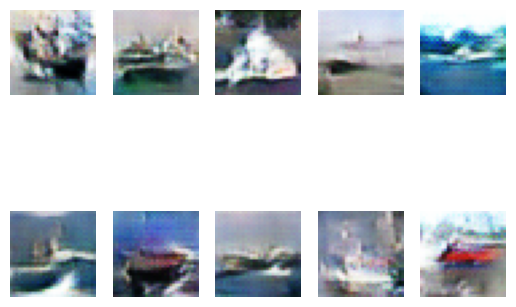

79/79 [==============================] - 5s 60ms/step - d_loss: -1.7917 - g_loss: 6.0986
Epoch 190/200
78/79 [============================>.] - ETA: 0s - d_loss: -1.8543 - g_loss: 6.3235

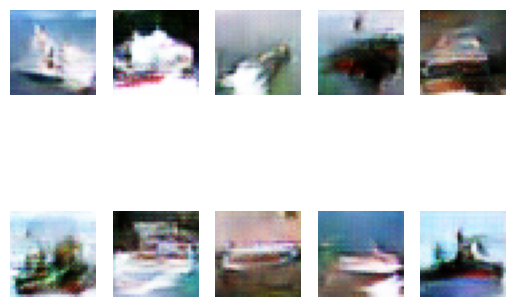

79/79 [==============================] - 5s 60ms/step - d_loss: -1.8634 - g_loss: 6.4199
Epoch 191/200
79/79 [==============================] - ETA: 0s - d_loss: -1.9649 - g_loss: 6.1554

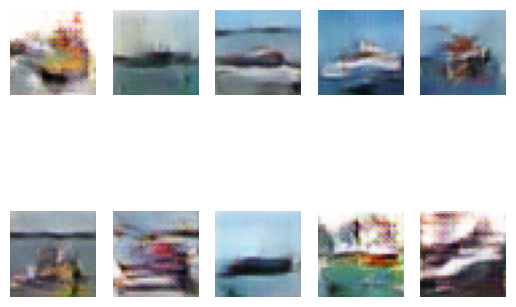

79/79 [==============================] - 4s 57ms/step - d_loss: -1.9743 - g_loss: 6.1447
Epoch 192/200
79/79 [==============================] - ETA: 0s - d_loss: -2.0448 - g_loss: 6.2928

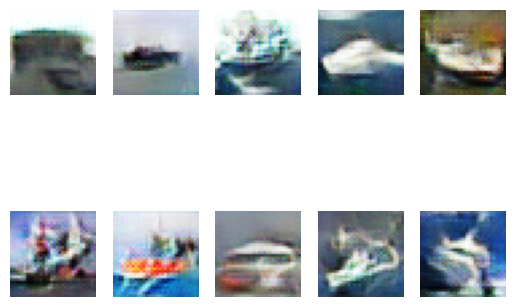

79/79 [==============================] - 5s 62ms/step - d_loss: -2.0586 - g_loss: 6.2617
Epoch 193/200
78/79 [============================>.] - ETA: 0s - d_loss: -1.7635 - g_loss: 5.7846

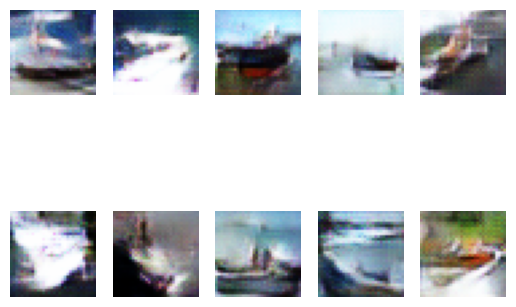

79/79 [==============================] - 4s 55ms/step - d_loss: -1.8841 - g_loss: 5.7837
Epoch 194/200
79/79 [==============================] - ETA: 0s - d_loss: -1.7288 - g_loss: 6.4987

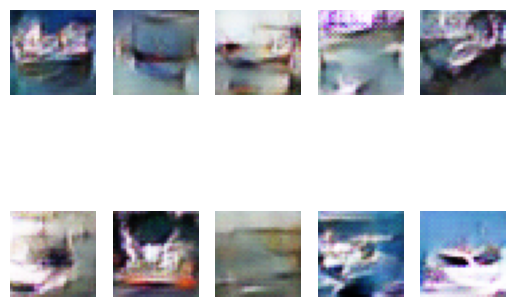

79/79 [==============================] - 4s 55ms/step - d_loss: -1.5469 - g_loss: 6.4848
Epoch 195/200
79/79 [==============================] - ETA: 0s - d_loss: -1.7659 - g_loss: 6.1613

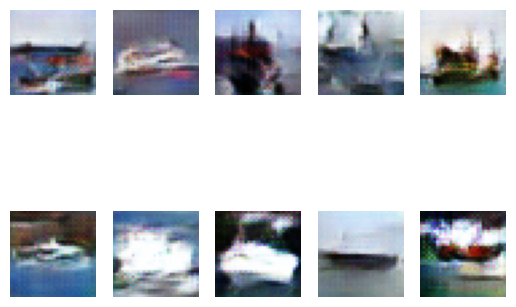

79/79 [==============================] - 5s 60ms/step - d_loss: -1.8022 - g_loss: 6.2079
Epoch 196/200
78/79 [============================>.] - ETA: 0s - d_loss: -1.6866 - g_loss: 6.0765

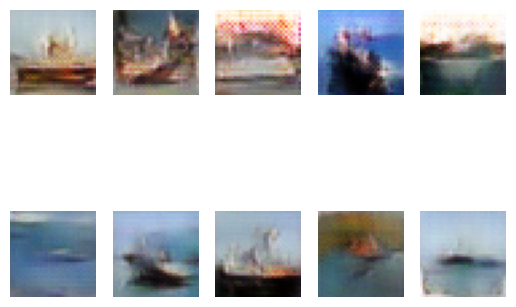

79/79 [==============================] - 5s 60ms/step - d_loss: -1.7058 - g_loss: 6.0962
Epoch 197/200
78/79 [============================>.] - ETA: 0s - d_loss: -1.7882 - g_loss: 6.6244

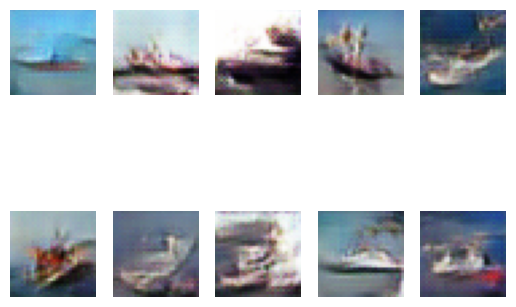

79/79 [==============================] - 5s 60ms/step - d_loss: -1.8547 - g_loss: 6.5795
Epoch 198/200
79/79 [==============================] - ETA: 0s - d_loss: -1.9247 - g_loss: 6.7504

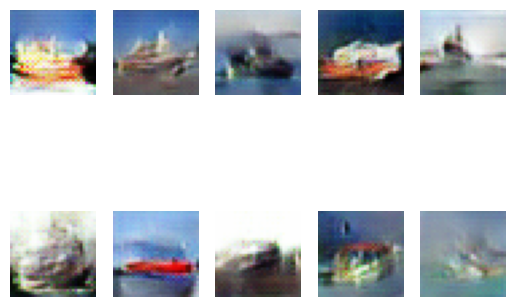

79/79 [==============================] - 5s 57ms/step - d_loss: -1.9599 - g_loss: 6.7920
Epoch 199/200
79/79 [==============================] - ETA: 0s - d_loss: -1.7838 - g_loss: 6.5496

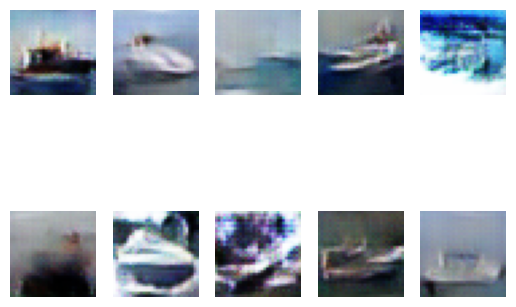

79/79 [==============================] - 5s 62ms/step - d_loss: -1.7941 - g_loss: 6.5563
Epoch 200/200
78/79 [============================>.] - ETA: 0s - d_loss: -1.8765 - g_loss: 6.4207

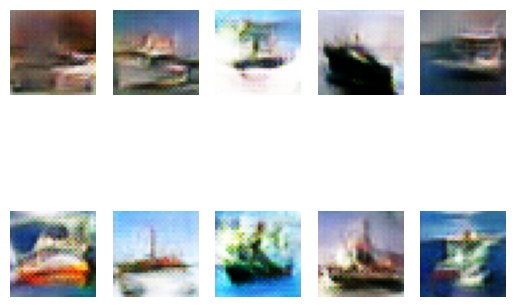

79/79 [==============================] - 5s 57ms/step - d_loss: -1.7603 - g_loss: 6.3839


In [ ]:
# Huấn luyện
start = time()
wgan.fit(x_train, batch_size=BATCH_SIZE, epochs=epochs, callbacks=[cbk])
end = time()
duration = end - start

In [ ]:
total_time = "Time: {}".format(sec_to_hours(duration))
print(total_time)

Time: 0 hours 15 mins 29 seconds


# **Evaluate**

In [ ]:
generator_file = str(model_dir) + '/generator_model.h5'

In [ ]:
generator.save(generator_file)

In [ ]:
def summarize_performance(generator, latent_dim, sample=10):
  noise = tf.random.normal(shape=(sample, latent_dim))
  x = generator.predict(noise)
  plot_img(x, sample)

1/1 [==============================] - 0s 164ms/step


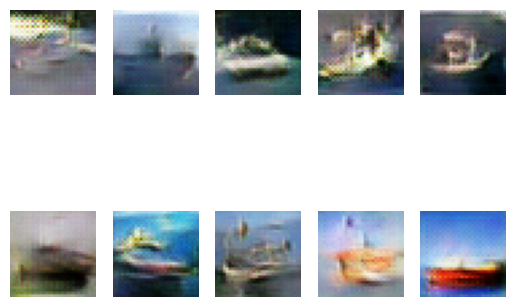

In [ ]:
summarize_performance(generator, latent_dim)